In [1]:
from __future__ import print_function,division
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
import glob

get_ipython().run_line_magic('matplotlib','inline')
plt.rcParams['figure.figsize'] = (10.0,8.0)
plt.rcParams['image.interpolation'] = 'nearest'
#plt.rcParams['image.cmap'] = 'gray'

In [2]:
def disp_images(images,type="color"):
    image_type = len(images.shape)
    images = np.reshape(images,[images.shape[0],-1])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    if type=="color":   
        global sqrtimg
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1]/3))) #--------------------------------------------------------        
    else:  
        print("error, need to revise")
    figure = plt.figure(figsize = (sqrtn,sqrtn))
    gs = gridspec.GridSpec(sqrtn,sqrtn)
    gs.update(wspace = 0.05,hspace = 0.05)
    for i,img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))

def preprocess(x):
    return 2*x-1.0
def deprocess(x):
    return (x+1.0) / 2.0
def count_params():
    param_count = np.sum([np.prod(x.get_shape().as_list()) for x in tf.global_variables()])
    return param_count
def session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    session = tf.Session(config = config)
    return session
def activation(x, alpha = 0.01):# leaky relu
    a = tf.maximum(x,alpha*x)
    return a
def sample_noise(batch_size,dim):
    random_noise = tf.random_uniform(maxval = 1,minval = -1,shape =[batch_size,dim])
    return random_noise

def get_solvers(lr = 1e-3, beta1 = 0.5):
    d_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    g_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    return d_solver,g_solver
def wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample):
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    lam = 10
    eps = tf.random_uniform([batch_size,1],minval=0.0,maxval=1.0)
    #a = tf.reshape(x,[batch_size,-1])    
    #b = tf.reshape(G_sample,[batch_size,-1])
    x_h = eps*x + (1-eps)*G_sample  #----------random relax search image-----------------------------------

    with tf.variable_scope("",reuse=True) as scope:# cannot understand gradient penalty
        #temp = tf.reshape(x_h,[batch_size,32,32,3])#-------------------------------------------change size
        grad_d_x_h = tf.gradients(discriminator(x_h),x_h)# [batch,32*32*3]
    grad_norm = tf.norm(grad_d_x_h[0],axis=1,ord='euclidean')#fetch x-gradient and apply euclidean calibration
    grad_pen = tf.reduce_mean(tf.square(grad_norm-1))
    
    d_loss += lam*grad_pen  #this is the key pivot at WGAN-GP
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss


def wgan_loss(logits_real,logits_fake,batch_size,x,G_sample):  #not yet regularization
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss

def dcgan_loss(logits_real,logits_fake,batch_size,x,G_sample): #not yet regularization
    d_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_real,1e-12,1.0)))-tf.reduce_mean(tf.log(tf.clip_by_value(1 - logits_fake,1e-12,1.0)))
    g_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_fake,1e-12,1.0)))
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss
###################loss
def fetch_img(path,amount=5000):
    image_list = []
    count = 0
    for filename in glob.glob(path + '/*.jpg'): #assuming gif
        count += 1
        im=mpimg.imread(filename)
        image_list.append(im)
        if count%5000 == 0:
            print(str(count) + "/50000")
        if count == amount:
            break
    cifar_10 = np.array(image_list)
    cifar_10 = cifar_10 * 1.0 / 255        #calibration from [0,255] to [0.0~1.0]
    print(cifar_10.shape)
    disp_images(cifar_10[:save_size])
    return cifar_10

(200, 96, 96, 3)


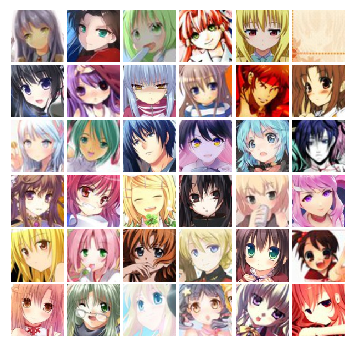

In [3]:
path = '/home/lw2435/faces'
fetch_amount = 200
batch_size = 36
noise_dim = 1024
log_dir='/home/lw2435' + '/DCGAN-v9'#------------------------------------------------------------------------
save_size = 36
cifar_10 = fetch_img(path,fetch_amount)

In [4]:
def attention(x,ch):
    with tf.variable_scope('attention', reuse=False):
        init = tf.contrib.layers.xavier_initializer()
        f = tf.layers.conv2d(x,filters=ch//8,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='ff_conv')
        g = tf.layers.conv2d(x,filters=ch//8,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='gg_conv')
        
        f = tf.reshape(f,shape=[f.shape[0],-1,f.shape[-1]])
        g = tf.reshape(g,shape=[g.shape[0],-1,g.shape[-1]])
        
        combine_f_g = tf.matmul(g,f,transpose_b=True)   #[batch,height,width,channel/8]
        combine_f_g = tf.nn.softmax(combine_f_g, dim=-1)#[batch,h*w,h*w]
        
        h = tf.layers.conv2d(x,filters=ch,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='hh_conv') #[batch,height,width,channel]
        h = tf.reshape(h,shape=[h.shape[0],-1,h.shape[-1]])      # [batch,h*w,channel]
        # N = h * w
        
        combine_f_g_h = tf.matmul(combine_f_g,h) # [batch,h*w,channel]
        combine_f_g_h = tf.reshape(combine_f_g_h, shape=x.shape)
        
        gamma = tf.get_variable("gamma",[1],initializer=tf.constant_initializer(0.0))
        x = gamma * combine_f_g_h + x

        return x
    
def generator(x):#for dcgan   input  [batch=128,noise_dim=1024]
    with tf.variable_scope("generator"):#zzz???????????????
        init = tf.contrib.layers.xavier_initializer()
        #reshape
        fc1 = tf.layers.dense(inputs=z,units=4*4*256,kernel_initializer=init,name='g_dense_0')  #[batch,4*4*256]#_--------------modify for all
        fc1 = tf.layers.batch_normalization(fc1,name='g_batchnorm_0')
        fc1 = tf.nn.relu(fc1)
        img = tf.reshape(fc1,[-1,4,4,256])                                              #[batch,4,4,256]   depth=256
        #deconv1
        img = tf.layers.conv2d_transpose(img,filters=128,kernel_size=4,strides=2,padding='same', #batch*8*8*128    strides=扩大几倍
                                                kernel_initializer=init,name='g_deconv_1')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_1')
        img = tf.nn.relu(img)
 
        img = tf.layers.conv2d_transpose(img,filters=64,kernel_size=4,strides=2,padding='same', #batch*16*16*64
                                                kernel_initializer=init,name='g_deconv_2')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_2')
        img = tf.nn.relu(img)
        
        img = attention(img,64)
        
        img = tf.layers.conv2d_transpose(img,filters=16,kernel_size=4,strides=2,padding='same', #batch*32*32*16
                                                kernel_initializer=init,name='g_deconv_3')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        img = tf.nn.relu(img)

        img = tf.layers.conv2d_transpose(img,filters=3,kernel_size=4,strides=2,padding='same', #batch*64*64*3 #-----------------------adding layer
                                                kernel_initializer=init,name='g_deconv_4')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_4')
        img = tf.nn.tanh(img)  #size down is a linear function !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
        #img = tf.layers.conv2d_transpose(img,3,4,strides=1,padding='same', #batch*32*32*3-------------------------------------
                                                #activation=tf.nn.tanh,kernel_initializer=init,name='g_deconv_4')#-------activation

        #img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        #img = tf.nn.relu(img)
        #reshape
        #img = tf.reshape(img,[-1,64*64*3]) #[batch,] #------------------------------change size
        
        #img = tf.layers.dense(inputs=img,units=96*96*3,kernel_initializer=init,name='g_dense_5') #----------adding layer
        
        #img = img / tf.maximum(tf.abs(tf.reduce_min(img)),tf.abs(tf.reduce_max(img)))
        #img = tf.layers.dense(inputs=img,units=,activation=tf.nn.tanh,name='tanh')#---------------change para   #change output size
        img = tf.image.resize_images(img,(img_size,img_size),method=0)
        img = tf.reshape(img,shape=[-1,img_size*img_size*3])
        return img

def train(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,
         show_every=250,print_every=50,batch_size=128,num_epoch=10):
    max_iter = int(cifar_10.shape[0]*num_epoch/batch_size)#===========================================
    offset = 0 #============================================================
    epoch_cur = 0
    for it in range(max_iter):
        if (it % show_every == 0):
            #print(sess.run(tf.reduce_max(G_sample)))
            #print(sess.run(tf.reduce_min(G_sample)))
            samples = deprocess(sess.run(G_sample))#-----------------------------take care to deprocess samples!!!
            fig = disp_images(samples[:64])# one global para
            plt.show()
            print()
        #fetch the minibatch and train
        #minibatch,minibatch_y = mnist.train.next_batch(batch_size)
        minibatch1 = cifar_10[offset : offset + batch_size]
        offset = offset + batch_size
        if (offset + batch_size >= cifar_10.shape[0]):    
            epoch_cur = epoch_cur + 1
            print("epoch:"+str(epoch_cur)+"---------------------------------")
            np.random.shuffle(cifar_10)
            offset = 0
        minibatch1 = minibatch1.reshape(minibatch1.shape[0],-1)# serialize all the pixels

        _,D_loss_curr = sess.run([D_train_step,D_loss],feed_dict = {x:minibatch1})
        _,G_loss_curr = sess.run([G_train_step,G_loss])
        #fetch the minibatch and train
        
        if (it % print_every == 0):
            print('Iter:{}, D:{:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
        if (it % show_every == 0):      
            rs = sess.run(merged,feed_dict = {x:minibatch1})#-------------------------------------------
            train_writer.add_summary(rs,it)
    print('Final images')
    samples = deprocess(sess.run(G_sample))
        
    fig = disp_images(samples[:save_size])# one global para
    plt.show()
  
def discriminator(x):#for wgan    input  [batch,32*32*3]
    with tf.variable_scope('discriminator'):
        init = tf.contrib.layers.xavier_initializer()
        
        x = tf.reshape(x,[-1,img_size*img_size*3])  #----------------------------------------change para:   [batch,96*96*3]
        #x = tf.reshape(x,[-1,img_size,img_size,3])  #generalize serialized pixels and bunch of pixels
        #x = tf.image.resize_images(x,(64,64),method=0)   #[batch,64,64,3]
        x = tf.layers.dense(x,3072,kernel_initializer=init,name='d_dense_0')#------we can never add batch normalization there
                                                                                #!!!!!!!!!!for down sample
        x = activation(x)
        
        x = tf.reshape(x,[-1,32,32,3])# one global para
        
        x = tf.layers.conv2d(x,64,4,strides=2,padding='same',  #batch*16*16*64
                            kernel_initializer=init,name='d_conv_1')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_1')
        x = activation(x)        

        x = attention(x,64)
        
        x = tf.layers.conv2d(x,128,4,strides=2,padding='same',  #batch*8*8*64
                            kernel_initializer=init,name='d_conv_2')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_2')
        x = activation(x)      
        
        x = tf.reshape(x,[-1,8*8*128])                              # [batch,(8*8*128)]
        #x = tf.layers.dense(x,1024,kernel_initializer=init,name='d_dense3')  #discriminator too strong
        logits = tf.layers.dense(x,1,kernel_initializer=init,name='logits')
        #logits = tf.nn.sigmoid(logits)
        return logits



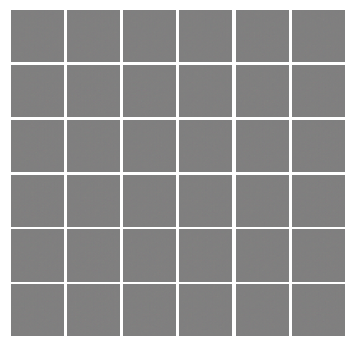


Iter:0, D:7.192, G:-0.1075
epoch:1---------------------------------
Iter:5, D:-56.56, G:-2.745
epoch:2---------------------------------
Iter:10, D:-228.3, G:66.79
epoch:3---------------------------------
Iter:15, D:-331.1, G:-70.5
epoch:4---------------------------------
Iter:20, D:67.86, G:0.9532
epoch:5---------------------------------
Iter:25, D:-144.2, G:5.057
epoch:6---------------------------------
Iter:30, D:-204.8, G:-45.44
epoch:7---------------------------------
Iter:35, D:20.54, G:25.58
epoch:8---------------------------------
Iter:40, D:-164.3, G:-9.911
epoch:9---------------------------------
Iter:45, D:-221.3, G:-16.28
epoch:10---------------------------------
Iter:50, D:-230.6, G:-47.83
epoch:11---------------------------------
Iter:55, D:-196.1, G:147.4
epoch:12---------------------------------
Iter:60, D:-87.33, G:-75.16
epoch:13---------------------------------
Iter:65, D:-220.4, G:149.6
epoch:14---------------------------------
Iter:70, D:-169.1, G:-90.0
epoch:15---

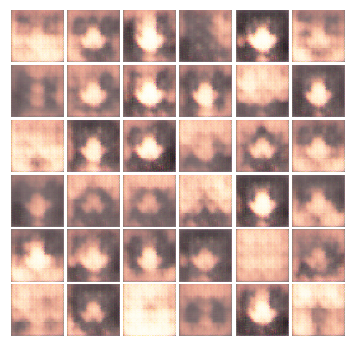


Iter:200, D:-29.3, G:32.08
epoch:41---------------------------------
Iter:205, D:-27.64, G:63.23
epoch:42---------------------------------
Iter:210, D:-47.05, G:-23.53
epoch:43---------------------------------
Iter:215, D:-28.54, G:33.22
epoch:44---------------------------------
Iter:220, D:-37.17, G:35.9
epoch:45---------------------------------
Iter:225, D:-50.49, G:-4.054
epoch:46---------------------------------
Iter:230, D:-28.15, G:-21.79
epoch:47---------------------------------
Iter:235, D:-51.79, G:226.3
epoch:48---------------------------------
Iter:240, D:-43.04, G:-32.92
epoch:49---------------------------------
Iter:245, D:-41.23, G:-41.7
epoch:50---------------------------------
Iter:250, D:21.9, G:175.7
epoch:51---------------------------------
Iter:255, D:-55.25, G:-23.31
epoch:52---------------------------------
Iter:260, D:-64.88, G:133.7
epoch:53---------------------------------
Iter:265, D:-49.54, G:-76.74
epoch:54---------------------------------
Iter:270, D:-31.7

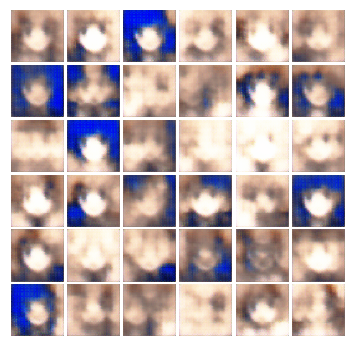


Iter:400, D:-20.47, G:-34.31
epoch:81---------------------------------
Iter:405, D:-17.64, G:23.13
epoch:82---------------------------------
Iter:410, D:-62.84, G:71.67
epoch:83---------------------------------
Iter:415, D:-58.07, G:-48.75
epoch:84---------------------------------
Iter:420, D:-64.65, G:106.3
epoch:85---------------------------------
Iter:425, D:-67.39, G:-35.98
epoch:86---------------------------------
Iter:430, D:-53.06, G:15.77
epoch:87---------------------------------
Iter:435, D:-71.63, G:-115.5
epoch:88---------------------------------
Iter:440, D:-47.0, G:-109.0
epoch:89---------------------------------
Iter:445, D:-51.7, G:23.82
epoch:90---------------------------------
Iter:450, D:-35.73, G:102.0
epoch:91---------------------------------
Iter:455, D:-29.46, G:37.75
epoch:92---------------------------------
Iter:460, D:-33.86, G:2.721
epoch:93---------------------------------
Iter:465, D:-66.12, G:11.74
epoch:94---------------------------------
Iter:470, D:-26.

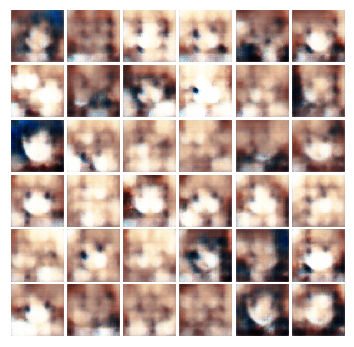


Iter:600, D:-57.28, G:-20.97
epoch:121---------------------------------
Iter:605, D:-54.35, G:2.167
epoch:122---------------------------------
Iter:610, D:-53.3, G:10.23
epoch:123---------------------------------
Iter:615, D:-57.31, G:-70.15
epoch:124---------------------------------
Iter:620, D:-70.35, G:62.55
epoch:125---------------------------------
Iter:625, D:-71.37, G:66.76
epoch:126---------------------------------
Iter:630, D:-68.87, G:-43.21
epoch:127---------------------------------
Iter:635, D:-46.58, G:56.56
epoch:128---------------------------------
Iter:640, D:-84.65, G:39.46
epoch:129---------------------------------
Iter:645, D:-40.3, G:44.31
epoch:130---------------------------------
Iter:650, D:-87.92, G:77.04
epoch:131---------------------------------
Iter:655, D:-59.18, G:-6.52
epoch:132---------------------------------
Iter:660, D:-75.33, G:0.7755
epoch:133---------------------------------
Iter:665, D:-45.9, G:103.1
epoch:134---------------------------------
Iter

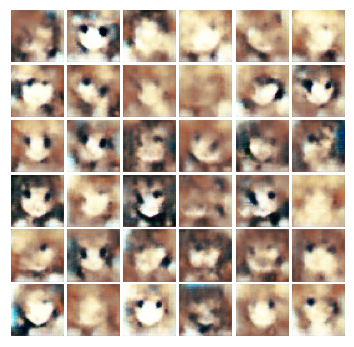


Iter:800, D:-88.93, G:4.485
epoch:161---------------------------------
Iter:805, D:-69.81, G:2.295
epoch:162---------------------------------
Iter:810, D:-112.2, G:99.81
epoch:163---------------------------------
Iter:815, D:-126.3, G:-30.81
epoch:164---------------------------------
Iter:820, D:-34.69, G:4.643
epoch:165---------------------------------
Iter:825, D:-95.77, G:76.13
epoch:166---------------------------------
Iter:830, D:-83.65, G:12.97
epoch:167---------------------------------
Iter:835, D:-91.04, G:5.771
epoch:168---------------------------------
Iter:840, D:-115.9, G:53.03
epoch:169---------------------------------
Iter:845, D:-106.7, G:65.37
epoch:170---------------------------------
Iter:850, D:-112.5, G:21.34
epoch:171---------------------------------
Iter:855, D:-74.18, G:-110.0
epoch:172---------------------------------
Iter:860, D:-117.1, G:82.52
epoch:173---------------------------------
Iter:865, D:-50.94, G:-11.67
epoch:174---------------------------------
It

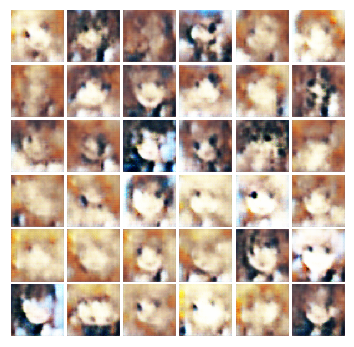


Iter:1000, D:-153.3, G:27.43
epoch:201---------------------------------
Iter:1005, D:-175.3, G:-10.56
epoch:202---------------------------------
Iter:1010, D:-142.4, G:137.4
epoch:203---------------------------------
Iter:1015, D:211.0, G:-182.5
epoch:204---------------------------------
Iter:1020, D:15.95, G:-18.02
epoch:205---------------------------------
Iter:1025, D:-23.3, G:0.8628
epoch:206---------------------------------
Iter:1030, D:-24.19, G:3.418
epoch:207---------------------------------
Iter:1035, D:-50.51, G:123.9
epoch:208---------------------------------
Iter:1040, D:-27.16, G:-37.12
epoch:209---------------------------------
Iter:1045, D:-40.01, G:-14.87
epoch:210---------------------------------
Iter:1050, D:-68.72, G:134.4
epoch:211---------------------------------
Iter:1055, D:-55.28, G:69.58
epoch:212---------------------------------
Iter:1060, D:-58.13, G:35.84
epoch:213---------------------------------
Iter:1065, D:-49.79, G:-8.199
epoch:214---------------------

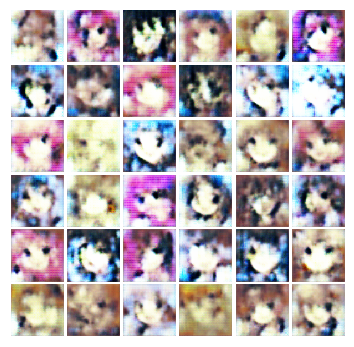


Iter:1200, D:-103.2, G:-10.56
epoch:241---------------------------------
Iter:1205, D:-52.86, G:153.6
epoch:242---------------------------------
Iter:1210, D:-147.3, G:-50.51
epoch:243---------------------------------
Iter:1215, D:-66.54, G:-2.443
epoch:244---------------------------------
Iter:1220, D:-21.91, G:36.53
epoch:245---------------------------------
Iter:1225, D:-159.5, G:104.2
epoch:246---------------------------------
Iter:1230, D:-162.0, G:-30.58
epoch:247---------------------------------
Iter:1235, D:-109.2, G:-55.05
epoch:248---------------------------------
Iter:1240, D:-194.5, G:26.75
epoch:249---------------------------------
Iter:1245, D:-169.0, G:-90.48
epoch:250---------------------------------
Iter:1250, D:-192.5, G:16.86
epoch:251---------------------------------
Iter:1255, D:-130.3, G:-37.16
epoch:252---------------------------------
Iter:1260, D:-114.9, G:-13.99
epoch:253---------------------------------
Iter:1265, D:-98.86, G:3.458
epoch:254-----------------

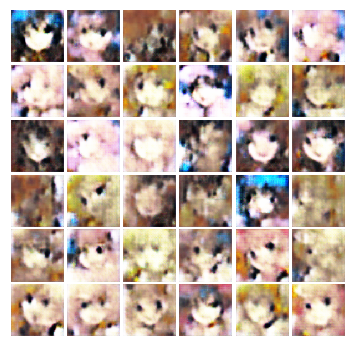


Iter:1400, D:-198.7, G:-15.58
epoch:281---------------------------------
Iter:1405, D:-178.9, G:96.48
epoch:282---------------------------------
Iter:1410, D:-194.6, G:176.3
epoch:283---------------------------------
Iter:1415, D:-206.7, G:-37.03
epoch:284---------------------------------
Iter:1420, D:-191.1, G:19.5
epoch:285---------------------------------
Iter:1425, D:-130.0, G:-58.35
epoch:286---------------------------------
Iter:1430, D:-185.8, G:96.35
epoch:287---------------------------------
Iter:1435, D:-132.1, G:-62.64
epoch:288---------------------------------
Iter:1440, D:-207.4, G:-67.74
epoch:289---------------------------------
Iter:1445, D:-193.8, G:-20.94
epoch:290---------------------------------
Iter:1450, D:-176.5, G:43.38
epoch:291---------------------------------
Iter:1455, D:-168.9, G:-28.72
epoch:292---------------------------------
Iter:1460, D:-159.3, G:7.63
epoch:293---------------------------------
Iter:1465, D:-144.0, G:-115.1
epoch:294-------------------

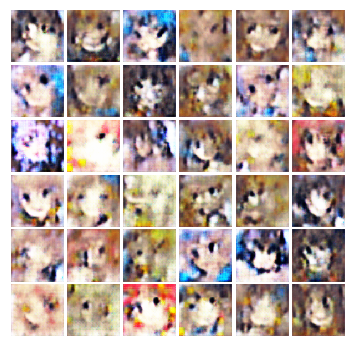


Iter:1600, D:-309.7, G:47.04
epoch:321---------------------------------
Iter:1605, D:-280.5, G:47.5
epoch:322---------------------------------
Iter:1610, D:-167.6, G:0.752
epoch:323---------------------------------
Iter:1615, D:-279.9, G:60.57
epoch:324---------------------------------
Iter:1620, D:-246.4, G:-72.53
epoch:325---------------------------------
Iter:1625, D:-205.1, G:43.1
epoch:326---------------------------------
Iter:1630, D:-187.2, G:8.773
epoch:327---------------------------------
Iter:1635, D:-267.2, G:-22.58
epoch:328---------------------------------
Iter:1640, D:-252.3, G:134.2
epoch:329---------------------------------
Iter:1645, D:-251.5, G:-59.61
epoch:330---------------------------------
Iter:1650, D:-199.0, G:-36.13
epoch:331---------------------------------
Iter:1655, D:-248.8, G:21.46
epoch:332---------------------------------
Iter:1660, D:-157.5, G:-104.0
epoch:333---------------------------------
Iter:1665, D:-213.8, G:115.5
epoch:334----------------------

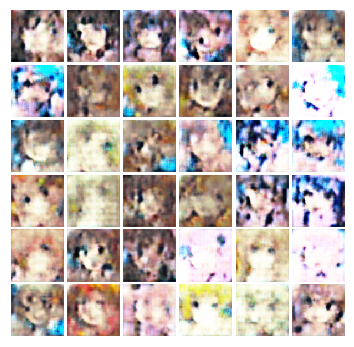


Iter:1800, D:-296.6, G:-60.14
epoch:361---------------------------------
Iter:1805, D:-383.8, G:96.14
epoch:362---------------------------------
Iter:1810, D:-95.24, G:132.8
epoch:363---------------------------------
Iter:1815, D:-380.0, G:-37.13
epoch:364---------------------------------
Iter:1820, D:-118.6, G:155.4
epoch:365---------------------------------
Iter:1825, D:-350.5, G:76.69
epoch:366---------------------------------
Iter:1830, D:-156.6, G:-0.918
epoch:367---------------------------------
Iter:1835, D:-339.1, G:72.47
epoch:368---------------------------------
Iter:1840, D:-212.7, G:76.09
epoch:369---------------------------------
Iter:1845, D:-382.3, G:25.31
epoch:370---------------------------------
Iter:1850, D:-233.7, G:120.1
epoch:371---------------------------------
Iter:1855, D:-224.4, G:-50.93
epoch:372---------------------------------
Iter:1860, D:-400.8, G:-43.24
epoch:373---------------------------------
Iter:1865, D:-340.1, G:73.63
epoch:374--------------------

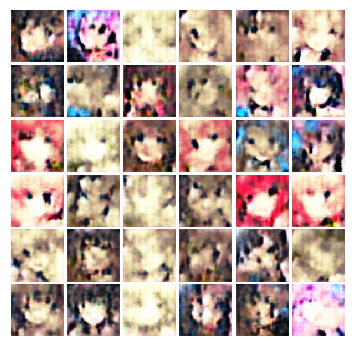


Iter:2000, D:-204.8, G:-38.07
epoch:401---------------------------------
Iter:2005, D:-148.3, G:175.8
epoch:402---------------------------------
Iter:2010, D:-195.0, G:-40.42
epoch:403---------------------------------
Iter:2015, D:-202.0, G:-5.774
epoch:404---------------------------------
Iter:2020, D:-144.8, G:3.484
epoch:405---------------------------------
Iter:2025, D:-160.3, G:9.587
epoch:406---------------------------------
Iter:2030, D:-187.7, G:-81.99
epoch:407---------------------------------
Iter:2035, D:-272.4, G:-8.85
epoch:408---------------------------------
Iter:2040, D:-185.5, G:30.99
epoch:409---------------------------------
Iter:2045, D:-236.4, G:58.89
epoch:410---------------------------------
Iter:2050, D:-218.6, G:-45.67
epoch:411---------------------------------
Iter:2055, D:-223.9, G:-10.39
epoch:412---------------------------------
Iter:2060, D:-154.7, G:-72.37
epoch:413---------------------------------
Iter:2065, D:-254.8, G:-68.42
epoch:414-----------------

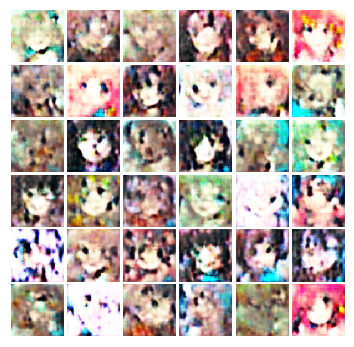


Iter:2200, D:-290.1, G:51.31
epoch:441---------------------------------
Iter:2205, D:-284.8, G:28.32
epoch:442---------------------------------
Iter:2210, D:-226.8, G:-62.27
epoch:443---------------------------------
Iter:2215, D:-341.8, G:184.2
epoch:444---------------------------------
Iter:2220, D:-300.5, G:12.36
epoch:445---------------------------------
Iter:2225, D:-221.8, G:-69.55
epoch:446---------------------------------
Iter:2230, D:-333.3, G:-14.86
epoch:447---------------------------------
Iter:2235, D:-305.4, G:-25.0
epoch:448---------------------------------
Iter:2240, D:-297.7, G:-223.9
epoch:449---------------------------------
Iter:2245, D:-294.7, G:54.85
epoch:450---------------------------------
Iter:2250, D:-200.3, G:-15.54
epoch:451---------------------------------
Iter:2255, D:-209.5, G:45.11
epoch:452---------------------------------
Iter:2260, D:-305.8, G:13.68
epoch:453---------------------------------
Iter:2265, D:-68.51, G:45.19
epoch:454--------------------

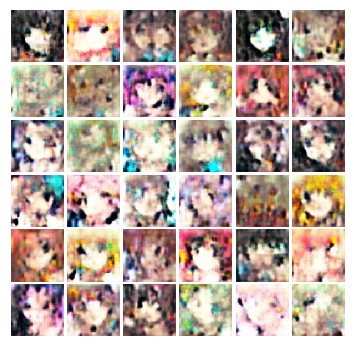


Iter:2400, D:-305.2, G:-40.44
epoch:481---------------------------------
Iter:2405, D:-234.9, G:60.0
epoch:482---------------------------------
Iter:2410, D:-400.5, G:-138.8
epoch:483---------------------------------
Iter:2415, D:-318.3, G:30.02
epoch:484---------------------------------
Iter:2420, D:-383.3, G:-14.59
epoch:485---------------------------------
Iter:2425, D:-382.7, G:-7.487
epoch:486---------------------------------
Iter:2430, D:-410.7, G:157.9
epoch:487---------------------------------
Iter:2435, D:-494.7, G:-166.4
epoch:488---------------------------------
Iter:2440, D:-286.9, G:-48.91
epoch:489---------------------------------
Iter:2445, D:-224.2, G:8.859
epoch:490---------------------------------
Iter:2450, D:-195.5, G:-42.74
epoch:491---------------------------------
Iter:2455, D:-288.7, G:-67.51
epoch:492---------------------------------
Iter:2460, D:-215.3, G:11.4
epoch:493---------------------------------
Iter:2465, D:-377.8, G:-73.85
epoch:494------------------

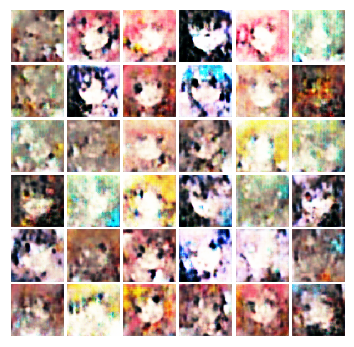


Iter:2600, D:-475.6, G:-24.52
epoch:521---------------------------------
Iter:2605, D:-443.4, G:48.73
epoch:522---------------------------------
Iter:2610, D:-381.7, G:67.42
epoch:523---------------------------------
Iter:2615, D:97.36, G:197.7
epoch:524---------------------------------
Iter:2620, D:-334.7, G:-81.46
epoch:525---------------------------------
Iter:2625, D:-469.9, G:26.65
epoch:526---------------------------------
Iter:2630, D:-366.2, G:-103.8
epoch:527---------------------------------
Iter:2635, D:-437.5, G:-12.62
epoch:528---------------------------------
Iter:2640, D:-259.2, G:-40.31
epoch:529---------------------------------
Iter:2645, D:-228.3, G:-70.13
epoch:530---------------------------------
Iter:2650, D:-472.6, G:50.47
epoch:531---------------------------------
Iter:2655, D:-489.4, G:31.2
epoch:532---------------------------------
Iter:2660, D:-384.3, G:80.97
epoch:533---------------------------------
Iter:2665, D:-412.9, G:-77.58
epoch:534--------------------

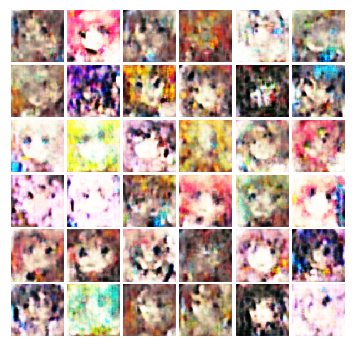


Iter:2800, D:-170.3, G:-157.8
epoch:561---------------------------------
Iter:2805, D:-470.2, G:65.58
epoch:562---------------------------------
Iter:2810, D:-536.9, G:-34.35
epoch:563---------------------------------
Iter:2815, D:-210.1, G:38.91
epoch:564---------------------------------
Iter:2820, D:-433.2, G:-52.95
epoch:565---------------------------------
Iter:2825, D:-352.9, G:144.6
epoch:566---------------------------------
Iter:2830, D:-409.3, G:42.88
epoch:567---------------------------------
Iter:2835, D:-405.4, G:-110.2
epoch:568---------------------------------
Iter:2840, D:-320.9, G:-4.595
epoch:569---------------------------------
Iter:2845, D:-458.7, G:-10.31
epoch:570---------------------------------
Iter:2850, D:-262.9, G:79.79
epoch:571---------------------------------
Iter:2855, D:-343.0, G:-93.74
epoch:572---------------------------------
Iter:2860, D:-462.7, G:-57.34
epoch:573---------------------------------
Iter:2865, D:-404.5, G:51.69
epoch:574-----------------

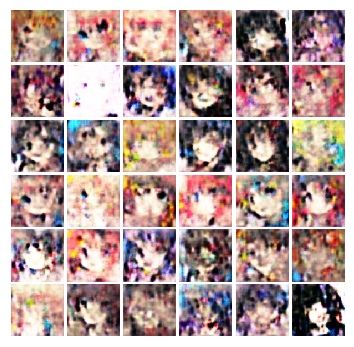


Iter:3000, D:-99.43, G:-129.2
epoch:601---------------------------------
Iter:3005, D:-402.0, G:-71.5
epoch:602---------------------------------
Iter:3010, D:-539.6, G:64.6
epoch:603---------------------------------
Iter:3015, D:-510.8, G:-64.0
epoch:604---------------------------------
Iter:3020, D:-88.13, G:-254.0
epoch:605---------------------------------
Iter:3025, D:-361.1, G:-47.31
epoch:606---------------------------------
Iter:3030, D:-295.3, G:-80.58
epoch:607---------------------------------
Iter:3035, D:-573.0, G:-44.43
epoch:608---------------------------------
Iter:3040, D:-421.0, G:158.2
epoch:609---------------------------------
Iter:3045, D:-495.3, G:-119.2
epoch:610---------------------------------
Iter:3050, D:-254.4, G:-9.897
epoch:611---------------------------------
Iter:3055, D:-294.6, G:130.3
epoch:612---------------------------------
Iter:3060, D:-321.5, G:-153.6
epoch:613---------------------------------
Iter:3065, D:-360.5, G:-3.408
epoch:614-----------------

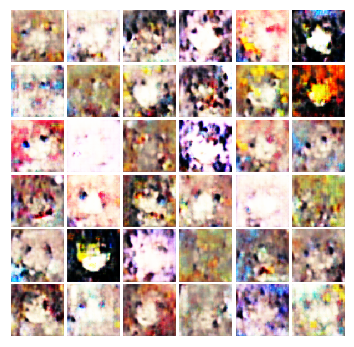


Iter:3200, D:-614.0, G:-7.466
epoch:641---------------------------------
Iter:3205, D:-489.2, G:-73.78
epoch:642---------------------------------
Iter:3210, D:-260.6, G:76.24
epoch:643---------------------------------
Iter:3215, D:-539.5, G:11.7
epoch:644---------------------------------
Iter:3220, D:-500.9, G:57.8
epoch:645---------------------------------
Iter:3225, D:-443.0, G:12.88
epoch:646---------------------------------
Iter:3230, D:-482.3, G:-21.93
epoch:647---------------------------------
Iter:3235, D:-428.1, G:-68.06
epoch:648---------------------------------
Iter:3240, D:-600.8, G:33.17
epoch:649---------------------------------
Iter:3245, D:-443.4, G:-72.31
epoch:650---------------------------------
Iter:3250, D:-168.6, G:-2.051
epoch:651---------------------------------
Iter:3255, D:-341.4, G:3.129
epoch:652---------------------------------
Iter:3260, D:-407.5, G:25.03
epoch:653---------------------------------
Iter:3265, D:-473.0, G:-22.39
epoch:654--------------------

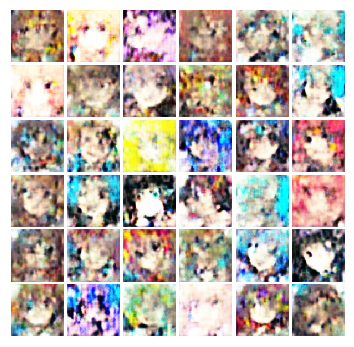


Iter:3400, D:-624.1, G:-52.38
epoch:681---------------------------------
Iter:3405, D:-635.5, G:36.68
epoch:682---------------------------------
Iter:3410, D:-435.6, G:-64.17
epoch:683---------------------------------
Iter:3415, D:-567.9, G:36.68
epoch:684---------------------------------
Iter:3420, D:-627.8, G:51.37
epoch:685---------------------------------
Iter:3425, D:-516.4, G:117.8
epoch:686---------------------------------
Iter:3430, D:-483.0, G:-33.55
epoch:687---------------------------------
Iter:3435, D:-596.3, G:81.87
epoch:688---------------------------------
Iter:3440, D:-376.9, G:33.62
epoch:689---------------------------------
Iter:3445, D:-751.3, G:17.89
epoch:690---------------------------------
Iter:3450, D:-385.1, G:-112.1
epoch:691---------------------------------
Iter:3455, D:-550.1, G:-22.88
epoch:692---------------------------------
Iter:3460, D:-517.3, G:196.1
epoch:693---------------------------------
Iter:3465, D:-544.5, G:173.5
epoch:694--------------------

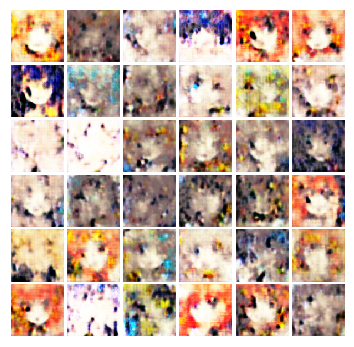


Iter:3600, D:-377.6, G:42.1
epoch:721---------------------------------
Iter:3605, D:-570.4, G:-0.4449
epoch:722---------------------------------
Iter:3610, D:-440.5, G:16.23
epoch:723---------------------------------
Iter:3615, D:-574.1, G:-27.94
epoch:724---------------------------------
Iter:3620, D:-304.4, G:-24.73
epoch:725---------------------------------
Iter:3625, D:-415.4, G:20.27
epoch:726---------------------------------
Iter:3630, D:-598.2, G:-45.48
epoch:727---------------------------------
Iter:3635, D:-737.5, G:77.91
epoch:728---------------------------------
Iter:3640, D:-373.5, G:78.15
epoch:729---------------------------------
Iter:3645, D:-519.0, G:167.2
epoch:730---------------------------------
Iter:3650, D:-420.9, G:-117.3
epoch:731---------------------------------
Iter:3655, D:-506.9, G:-230.8
epoch:732---------------------------------
Iter:3660, D:-512.2, G:-3.865
epoch:733---------------------------------
Iter:3665, D:-175.5, G:14.48
epoch:734------------------

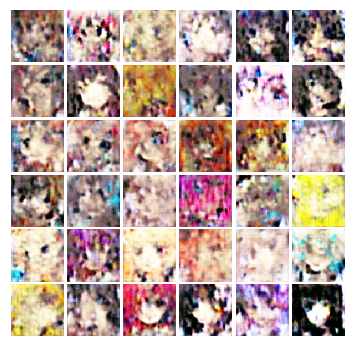


Iter:3800, D:-621.8, G:-47.61
epoch:761---------------------------------
Iter:3805, D:-554.2, G:-37.59
epoch:762---------------------------------
Iter:3810, D:-437.4, G:-42.71
epoch:763---------------------------------
Iter:3815, D:-370.4, G:110.6
epoch:764---------------------------------
Iter:3820, D:-588.1, G:40.19
epoch:765---------------------------------
Iter:3825, D:-443.9, G:-179.2
epoch:766---------------------------------
Iter:3830, D:-320.9, G:-109.1
epoch:767---------------------------------
Iter:3835, D:-420.0, G:-29.96
epoch:768---------------------------------
Iter:3840, D:-585.2, G:60.47
epoch:769---------------------------------
Iter:3845, D:-531.9, G:-21.52
epoch:770---------------------------------
Iter:3850, D:-596.3, G:-21.01
epoch:771---------------------------------
Iter:3855, D:-726.3, G:-43.34
epoch:772---------------------------------
Iter:3860, D:-695.6, G:-55.39
epoch:773---------------------------------
Iter:3865, D:-278.8, G:-12.91
epoch:774--------------

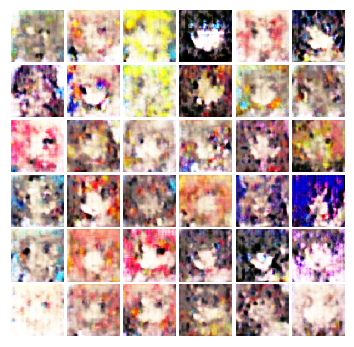


Iter:4000, D:-443.5, G:-93.3
epoch:801---------------------------------
Iter:4005, D:-620.0, G:235.4
epoch:802---------------------------------
Iter:4010, D:314.0, G:379.0
epoch:803---------------------------------
Iter:4015, D:-522.6, G:86.04
epoch:804---------------------------------
Iter:4020, D:-297.6, G:60.28
epoch:805---------------------------------
Iter:4025, D:-568.6, G:-76.95
epoch:806---------------------------------
Iter:4030, D:-665.5, G:35.46
epoch:807---------------------------------
Iter:4035, D:-1.131e+03, G:445.6
epoch:808---------------------------------
Iter:4040, D:1.359e+03, G:82.29
epoch:809---------------------------------
Iter:4045, D:-605.3, G:-87.8
epoch:810---------------------------------
Iter:4050, D:-374.6, G:-77.44
epoch:811---------------------------------
Iter:4055, D:-333.2, G:12.12
epoch:812---------------------------------
Iter:4060, D:-243.4, G:55.66
epoch:813---------------------------------
Iter:4065, D:-499.3, G:32.6
epoch:814------------------

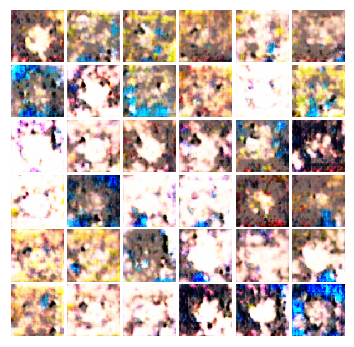


Iter:4200, D:-267.2, G:123.1
epoch:841---------------------------------
Iter:4205, D:-265.7, G:46.78
epoch:842---------------------------------
Iter:4210, D:-291.0, G:79.34
epoch:843---------------------------------
Iter:4215, D:-201.6, G:-19.27
epoch:844---------------------------------
Iter:4220, D:-423.2, G:11.68
epoch:845---------------------------------
Iter:4225, D:-435.6, G:-8.34
epoch:846---------------------------------
Iter:4230, D:-370.3, G:7.686
epoch:847---------------------------------
Iter:4235, D:-242.8, G:-49.43
epoch:848---------------------------------
Iter:4240, D:-169.3, G:-20.69
epoch:849---------------------------------
Iter:4245, D:-202.6, G:-62.64
epoch:850---------------------------------
Iter:4250, D:-348.0, G:-55.29
epoch:851---------------------------------
Iter:4255, D:-197.4, G:8.798
epoch:852---------------------------------
Iter:4260, D:-420.8, G:29.89
epoch:853---------------------------------
Iter:4265, D:-394.9, G:61.46
epoch:854--------------------

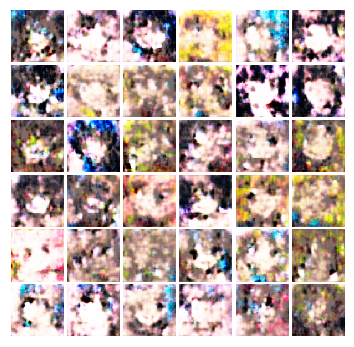


Iter:4400, D:-185.2, G:30.02
epoch:881---------------------------------
Iter:4405, D:-22.68, G:96.45
epoch:882---------------------------------
Iter:4410, D:-96.38, G:-74.78
epoch:883---------------------------------
Iter:4415, D:-44.54, G:60.82
epoch:884---------------------------------
Iter:4420, D:-199.0, G:-128.3
epoch:885---------------------------------
Iter:4425, D:-183.9, G:-149.8
epoch:886---------------------------------
Iter:4430, D:-84.57, G:69.61
epoch:887---------------------------------
Iter:4435, D:-90.65, G:-83.66
epoch:888---------------------------------
Iter:4440, D:-169.5, G:-52.66
epoch:889---------------------------------
Iter:4445, D:-184.0, G:80.43
epoch:890---------------------------------
Iter:4450, D:-226.9, G:-6.624
epoch:891---------------------------------
Iter:4455, D:-234.9, G:135.2
epoch:892---------------------------------
Iter:4460, D:-164.8, G:-91.46
epoch:893---------------------------------
Iter:4465, D:-176.6, G:-34.6
epoch:894------------------

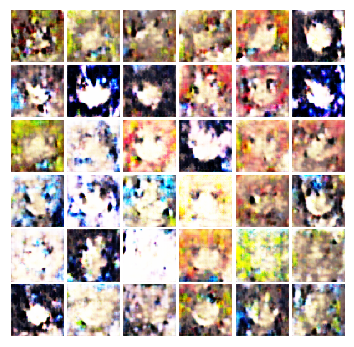


Iter:4600, D:-202.4, G:-156.6
epoch:921---------------------------------
Iter:4605, D:-218.3, G:-77.07
epoch:922---------------------------------
Iter:4610, D:-253.6, G:-29.82
epoch:923---------------------------------
Iter:4615, D:-237.9, G:30.76
epoch:924---------------------------------
Iter:4620, D:-257.9, G:21.56
epoch:925---------------------------------
Iter:4625, D:-166.8, G:-39.8
epoch:926---------------------------------
Iter:4630, D:-225.5, G:16.19
epoch:927---------------------------------
Iter:4635, D:-276.2, G:-88.38
epoch:928---------------------------------
Iter:4640, D:-237.6, G:3.57
epoch:929---------------------------------
Iter:4645, D:-278.5, G:-37.86
epoch:930---------------------------------
Iter:4650, D:-134.8, G:-128.6
epoch:931---------------------------------
Iter:4655, D:-293.4, G:57.46
epoch:932---------------------------------
Iter:4660, D:-388.1, G:-109.6
epoch:933---------------------------------
Iter:4665, D:-97.34, G:61.77
epoch:934-------------------

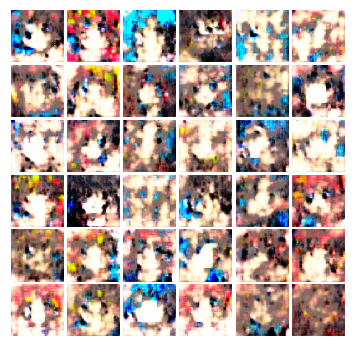


Iter:4800, D:-144.8, G:-0.8161
epoch:961---------------------------------
Iter:4805, D:-403.2, G:150.5
epoch:962---------------------------------
Iter:4810, D:-364.0, G:15.66
epoch:963---------------------------------
Iter:4815, D:-213.9, G:53.19
epoch:964---------------------------------
Iter:4820, D:-139.8, G:-20.83
epoch:965---------------------------------
Iter:4825, D:-148.4, G:37.36
epoch:966---------------------------------
Iter:4830, D:-274.5, G:60.54
epoch:967---------------------------------
Iter:4835, D:-144.1, G:-65.4
epoch:968---------------------------------
Iter:4840, D:-274.9, G:70.26
epoch:969---------------------------------
Iter:4845, D:-16.77, G:-49.85
epoch:970---------------------------------
Iter:4850, D:-233.6, G:143.1
epoch:971---------------------------------
Iter:4855, D:-217.2, G:-67.77
epoch:972---------------------------------
Iter:4860, D:-0.9145, G:82.44
epoch:973---------------------------------
Iter:4865, D:-270.8, G:33.62
epoch:974-------------------

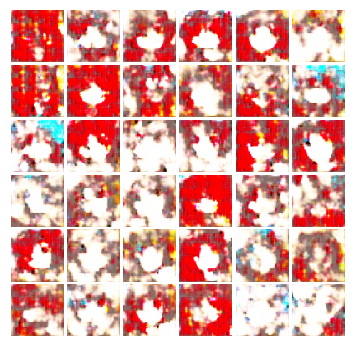


Iter:5000, D:-46.04, G:241.5
epoch:1001---------------------------------
Iter:5005, D:104.7, G:27.25
epoch:1002---------------------------------
Iter:5010, D:-249.0, G:26.34
epoch:1003---------------------------------
Iter:5015, D:-3.512, G:7.359
epoch:1004---------------------------------
Iter:5020, D:407.0, G:21.33
epoch:1005---------------------------------
Iter:5025, D:26.28, G:6.926
epoch:1006---------------------------------
Iter:5030, D:66.8, G:10.14
epoch:1007---------------------------------
Iter:5035, D:-68.35, G:13.0
epoch:1008---------------------------------
Iter:5040, D:-135.7, G:44.27
epoch:1009---------------------------------
Iter:5045, D:-120.9, G:-51.91
epoch:1010---------------------------------
Iter:5050, D:-107.5, G:71.46
epoch:1011---------------------------------
Iter:5055, D:-150.7, G:-9.765
epoch:1012---------------------------------
Iter:5060, D:-99.02, G:109.6
epoch:1013---------------------------------
Iter:5065, D:-127.1, G:-7.823
epoch:1014--------------

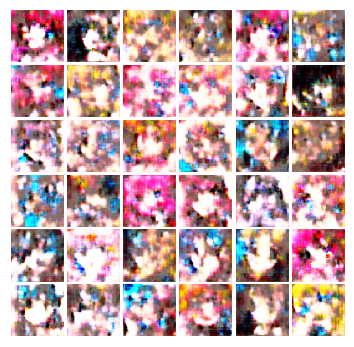


Iter:5200, D:-134.0, G:12.22
epoch:1041---------------------------------
Iter:5205, D:-67.18, G:-85.25
epoch:1042---------------------------------
Iter:5210, D:-222.9, G:61.13
epoch:1043---------------------------------
Iter:5215, D:-378.8, G:76.19
epoch:1044---------------------------------
Iter:5220, D:-209.9, G:-111.5
epoch:1045---------------------------------
Iter:5225, D:-239.5, G:21.46
epoch:1046---------------------------------
Iter:5230, D:-110.0, G:3.469
epoch:1047---------------------------------
Iter:5235, D:-64.33, G:249.2
epoch:1048---------------------------------
Iter:5240, D:-209.0, G:-21.46
epoch:1049---------------------------------
Iter:5245, D:-284.8, G:36.19
epoch:1050---------------------------------
Iter:5250, D:-117.4, G:28.64
epoch:1051---------------------------------
Iter:5255, D:-292.2, G:50.64
epoch:1052---------------------------------
Iter:5260, D:-215.0, G:123.2
epoch:1053---------------------------------
Iter:5265, D:-231.4, G:-11.21
epoch:1054-------

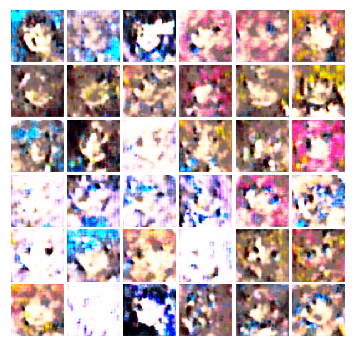


Iter:5400, D:-34.44, G:-138.2
epoch:1081---------------------------------
Iter:5405, D:181.4, G:34.37
epoch:1082---------------------------------
Iter:5410, D:-147.9, G:39.07
epoch:1083---------------------------------
Iter:5415, D:-130.7, G:-60.71
epoch:1084---------------------------------
Iter:5420, D:16.81, G:-18.21
epoch:1085---------------------------------
Iter:5425, D:29.47, G:-15.82
epoch:1086---------------------------------
Iter:5430, D:-317.7, G:63.36
epoch:1087---------------------------------
Iter:5435, D:-83.7, G:-23.76
epoch:1088---------------------------------
Iter:5440, D:-154.1, G:47.29
epoch:1089---------------------------------
Iter:5445, D:-192.7, G:-36.05
epoch:1090---------------------------------
Iter:5450, D:-141.7, G:-38.17
epoch:1091---------------------------------
Iter:5455, D:-109.4, G:2.302
epoch:1092---------------------------------
Iter:5460, D:-103.5, G:31.21
epoch:1093---------------------------------
Iter:5465, D:-139.3, G:49.85
epoch:1094--------

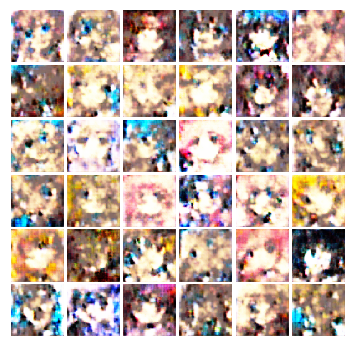


Iter:5600, D:-96.42, G:-117.7
epoch:1121---------------------------------
Iter:5605, D:-265.8, G:26.61
epoch:1122---------------------------------
Iter:5610, D:-277.0, G:46.32
epoch:1123---------------------------------
Iter:5615, D:-196.0, G:-168.0
epoch:1124---------------------------------
Iter:5620, D:-123.6, G:-13.74
epoch:1125---------------------------------
Iter:5625, D:-447.7, G:-10.52
epoch:1126---------------------------------
Iter:5630, D:-294.6, G:-29.81
epoch:1127---------------------------------
Iter:5635, D:-201.7, G:16.17
epoch:1128---------------------------------
Iter:5640, D:-197.1, G:-56.93
epoch:1129---------------------------------
Iter:5645, D:-250.5, G:26.15
epoch:1130---------------------------------
Iter:5650, D:-311.8, G:38.17
epoch:1131---------------------------------
Iter:5655, D:-184.4, G:53.7
epoch:1132---------------------------------
Iter:5660, D:-339.3, G:125.3
epoch:1133---------------------------------
Iter:5665, D:-134.3, G:-12.38
epoch:1134-----

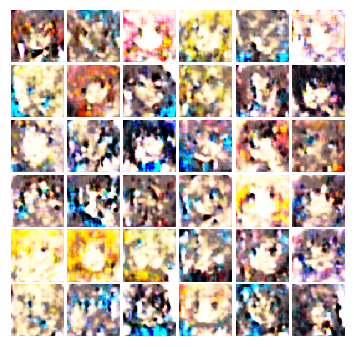


Iter:5800, D:-89.93, G:-19.19
epoch:1161---------------------------------
Iter:5805, D:-219.1, G:-58.63
epoch:1162---------------------------------
Iter:5810, D:-280.7, G:35.36
epoch:1163---------------------------------
Iter:5815, D:-357.5, G:-100.6
epoch:1164---------------------------------
Iter:5820, D:-227.6, G:85.22
epoch:1165---------------------------------
Iter:5825, D:-425.1, G:96.09
epoch:1166---------------------------------
Iter:5830, D:-389.7, G:-92.91
epoch:1167---------------------------------
Iter:5835, D:-319.1, G:2.491
epoch:1168---------------------------------
Iter:5840, D:-211.1, G:69.98
epoch:1169---------------------------------
Iter:5845, D:-40.8, G:1.627
epoch:1170---------------------------------
Iter:5850, D:-340.2, G:-14.74
epoch:1171---------------------------------
Iter:5855, D:-23.37, G:-112.8
epoch:1172---------------------------------
Iter:5860, D:-310.5, G:-24.25
epoch:1173---------------------------------
Iter:5865, D:-170.9, G:-41.18
epoch:1174----

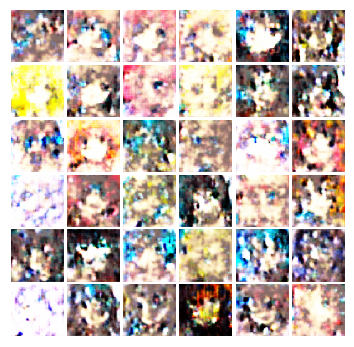


Iter:6000, D:-230.9, G:-18.05
epoch:1201---------------------------------
Iter:6005, D:-82.0, G:127.0
epoch:1202---------------------------------
Iter:6010, D:-337.0, G:2.732
epoch:1203---------------------------------
Iter:6015, D:-420.2, G:-40.86
epoch:1204---------------------------------
Iter:6020, D:30.46, G:102.1
epoch:1205---------------------------------
Iter:6025, D:-323.7, G:14.18
epoch:1206---------------------------------
Iter:6030, D:-303.3, G:-51.8
epoch:1207---------------------------------
Iter:6035, D:-394.3, G:18.35
epoch:1208---------------------------------
Iter:6040, D:-342.9, G:-74.89
epoch:1209---------------------------------
Iter:6045, D:-376.4, G:236.8
epoch:1210---------------------------------
Iter:6050, D:-271.1, G:-142.6
epoch:1211---------------------------------
Iter:6055, D:-436.9, G:146.0
epoch:1212---------------------------------
Iter:6060, D:-341.1, G:-20.14
epoch:1213---------------------------------
Iter:6065, D:-463.4, G:48.43
epoch:1214--------

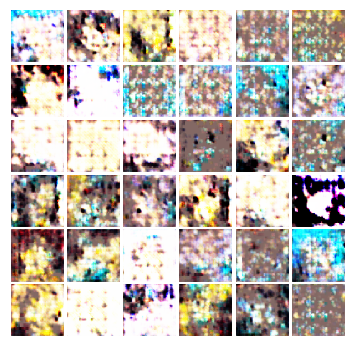


Iter:6200, D:-273.8, G:23.94
epoch:1241---------------------------------
Iter:6205, D:-353.8, G:134.7
epoch:1242---------------------------------
Iter:6210, D:-264.9, G:-16.58
epoch:1243---------------------------------
Iter:6215, D:105.4, G:-34.26
epoch:1244---------------------------------
Iter:6220, D:-325.3, G:-99.68
epoch:1245---------------------------------
Iter:6225, D:-336.7, G:-9.517
epoch:1246---------------------------------
Iter:6230, D:-247.4, G:-7.464
epoch:1247---------------------------------
Iter:6235, D:-86.55, G:32.94
epoch:1248---------------------------------
Iter:6240, D:-295.4, G:-81.13
epoch:1249---------------------------------
Iter:6245, D:-296.8, G:-109.5
epoch:1250---------------------------------
Iter:6250, D:-415.0, G:-43.5
epoch:1251---------------------------------
Iter:6255, D:-317.1, G:40.3
epoch:1252---------------------------------
Iter:6260, D:-454.8, G:147.7
epoch:1253---------------------------------
Iter:6265, D:-175.3, G:-128.8
epoch:1254-----

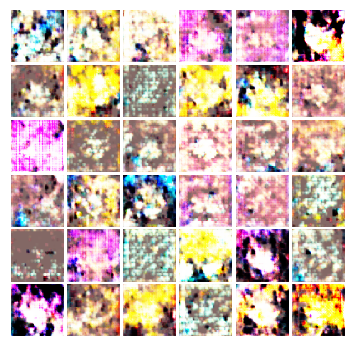


Iter:6400, D:-503.7, G:93.45
epoch:1281---------------------------------
Iter:6405, D:-528.7, G:90.24
epoch:1282---------------------------------
Iter:6410, D:-395.8, G:26.76
epoch:1283---------------------------------
Iter:6415, D:-546.2, G:176.6
epoch:1284---------------------------------
Iter:6420, D:-274.7, G:3.782
epoch:1285---------------------------------
Iter:6425, D:-367.4, G:90.15
epoch:1286---------------------------------
Iter:6430, D:-310.5, G:100.6
epoch:1287---------------------------------
Iter:6435, D:-244.7, G:57.43
epoch:1288---------------------------------
Iter:6440, D:-434.0, G:-112.0
epoch:1289---------------------------------
Iter:6445, D:-194.2, G:29.8
epoch:1290---------------------------------
Iter:6450, D:-221.4, G:-11.11
epoch:1291---------------------------------
Iter:6455, D:-551.7, G:-2.506
epoch:1292---------------------------------
Iter:6460, D:-249.7, G:175.5
epoch:1293---------------------------------
Iter:6465, D:-355.4, G:-5.026
epoch:1294--------

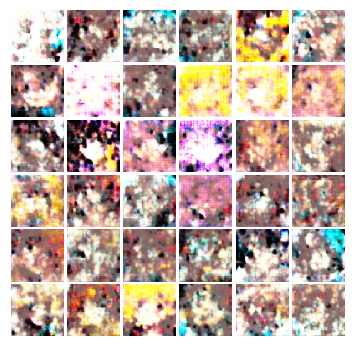


Iter:6600, D:-585.0, G:49.31
epoch:1321---------------------------------
Iter:6605, D:-223.3, G:95.02
epoch:1322---------------------------------
Iter:6610, D:-436.3, G:-139.7
epoch:1323---------------------------------
Iter:6615, D:-367.3, G:-118.0
epoch:1324---------------------------------
Iter:6620, D:-435.0, G:62.13
epoch:1325---------------------------------
Iter:6625, D:-359.3, G:-53.32
epoch:1326---------------------------------
Iter:6630, D:-481.3, G:-44.81
epoch:1327---------------------------------
Iter:6635, D:-161.5, G:-83.08
epoch:1328---------------------------------
Iter:6640, D:-202.1, G:58.33
epoch:1329---------------------------------
Iter:6645, D:-533.9, G:0.1248
epoch:1330---------------------------------
Iter:6650, D:-453.1, G:89.76
epoch:1331---------------------------------
Iter:6655, D:-416.5, G:28.15
epoch:1332---------------------------------
Iter:6660, D:-450.8, G:119.4
epoch:1333---------------------------------
Iter:6665, D:-401.5, G:-71.73
epoch:1334----

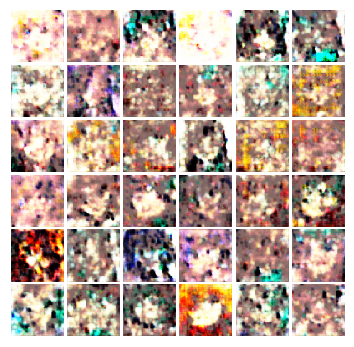


Iter:6800, D:-210.8, G:-11.68
epoch:1361---------------------------------
Iter:6805, D:-642.2, G:-101.9
epoch:1362---------------------------------
Iter:6810, D:-430.2, G:28.35
epoch:1363---------------------------------
Iter:6815, D:-463.6, G:90.21
epoch:1364---------------------------------
Iter:6820, D:-647.0, G:-59.18
epoch:1365---------------------------------
Iter:6825, D:-434.8, G:3.985
epoch:1366---------------------------------
Iter:6830, D:-599.3, G:66.92
epoch:1367---------------------------------
Iter:6835, D:-302.6, G:103.7
epoch:1368---------------------------------
Iter:6840, D:-349.0, G:-58.12
epoch:1369---------------------------------
Iter:6845, D:-230.9, G:-50.53
epoch:1370---------------------------------
Iter:6850, D:-337.7, G:-26.92
epoch:1371---------------------------------
Iter:6855, D:-330.1, G:67.37
epoch:1372---------------------------------
Iter:6860, D:-411.4, G:-27.69
epoch:1373---------------------------------
Iter:6865, D:-441.1, G:-82.63
epoch:1374---

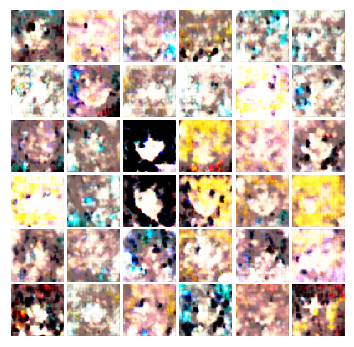


Iter:7000, D:-351.8, G:-1.723
epoch:1401---------------------------------
Iter:7005, D:-606.1, G:57.4
epoch:1402---------------------------------
Iter:7010, D:-174.8, G:-69.99
epoch:1403---------------------------------
Iter:7015, D:-447.3, G:-41.54
epoch:1404---------------------------------
Iter:7020, D:-265.2, G:68.74
epoch:1405---------------------------------
Iter:7025, D:-731.2, G:-67.25
epoch:1406---------------------------------
Iter:7030, D:-341.4, G:-60.14
epoch:1407---------------------------------
Iter:7035, D:-374.1, G:-22.84
epoch:1408---------------------------------
Iter:7040, D:-602.2, G:122.8
epoch:1409---------------------------------
Iter:7045, D:-548.8, G:10.9
epoch:1410---------------------------------
Iter:7050, D:-743.3, G:3.313
epoch:1411---------------------------------
Iter:7055, D:-296.4, G:-28.0
epoch:1412---------------------------------
Iter:7060, D:-450.6, G:-49.37
epoch:1413---------------------------------
Iter:7065, D:-246.1, G:-18.07
epoch:1414-----

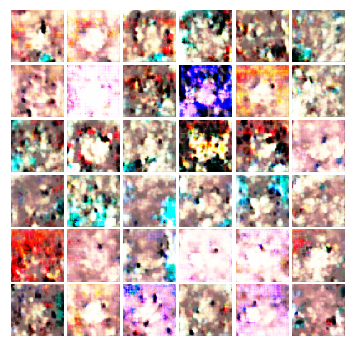


Iter:7200, D:-301.3, G:54.1
epoch:1441---------------------------------
Iter:7205, D:-476.3, G:26.2
epoch:1442---------------------------------
Iter:7210, D:-166.2, G:314.6
epoch:1443---------------------------------
Iter:7215, D:-623.6, G:-107.9
epoch:1444---------------------------------
Iter:7220, D:-255.5, G:24.42
epoch:1445---------------------------------
Iter:7225, D:-478.6, G:34.82
epoch:1446---------------------------------
Iter:7230, D:-566.8, G:55.48
epoch:1447---------------------------------
Iter:7235, D:-431.8, G:-144.6
epoch:1448---------------------------------
Iter:7240, D:-261.3, G:35.34
epoch:1449---------------------------------
Iter:7245, D:-619.1, G:-17.64
epoch:1450---------------------------------
Iter:7250, D:-225.9, G:35.24
epoch:1451---------------------------------
Iter:7255, D:-188.0, G:31.66
epoch:1452---------------------------------
Iter:7260, D:-297.0, G:-12.29
epoch:1453---------------------------------
Iter:7265, D:-495.3, G:38.94
epoch:1454---------

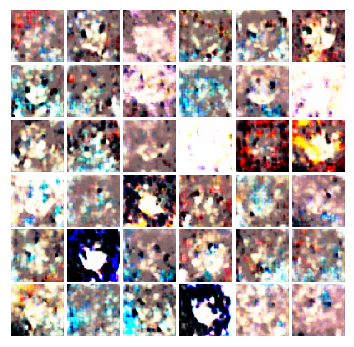


Iter:7400, D:-317.7, G:-29.08
epoch:1481---------------------------------
Iter:7405, D:-195.0, G:-43.99
epoch:1482---------------------------------
Iter:7410, D:-325.1, G:-39.4
epoch:1483---------------------------------
Iter:7415, D:-477.8, G:-29.41
epoch:1484---------------------------------
Iter:7420, D:-247.8, G:-88.07
epoch:1485---------------------------------
Iter:7425, D:-396.2, G:-15.98
epoch:1486---------------------------------
Iter:7430, D:-721.6, G:54.5
epoch:1487---------------------------------
Iter:7435, D:-544.7, G:145.3
epoch:1488---------------------------------
Iter:7440, D:-311.7, G:-15.51
epoch:1489---------------------------------
Iter:7445, D:-330.3, G:-32.35
epoch:1490---------------------------------
Iter:7450, D:67.2, G:177.9
epoch:1491---------------------------------
Iter:7455, D:-305.7, G:21.44
epoch:1492---------------------------------
Iter:7460, D:-332.2, G:-56.72
epoch:1493---------------------------------
Iter:7465, D:-360.8, G:10.69
epoch:1494------

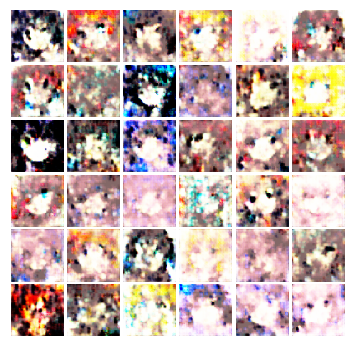


Iter:7600, D:-544.5, G:-68.37
epoch:1521---------------------------------
Iter:7605, D:-697.0, G:2.142
epoch:1522---------------------------------
Iter:7610, D:-598.3, G:-58.05
epoch:1523---------------------------------
Iter:7615, D:-476.2, G:-100.8
epoch:1524---------------------------------
Iter:7620, D:-745.1, G:14.51
epoch:1525---------------------------------
Iter:7625, D:-528.4, G:-163.0
epoch:1526---------------------------------
Iter:7630, D:-409.6, G:-26.62
epoch:1527---------------------------------
Iter:7635, D:-491.0, G:-20.06
epoch:1528---------------------------------
Iter:7640, D:-349.8, G:93.66
epoch:1529---------------------------------
Iter:7645, D:-217.4, G:-44.68
epoch:1530---------------------------------
Iter:7650, D:-587.5, G:-58.1
epoch:1531---------------------------------
Iter:7655, D:-346.9, G:-54.93
epoch:1532---------------------------------
Iter:7660, D:-505.5, G:-24.06
epoch:1533---------------------------------
Iter:7665, D:-627.3, G:35.12
epoch:1534--

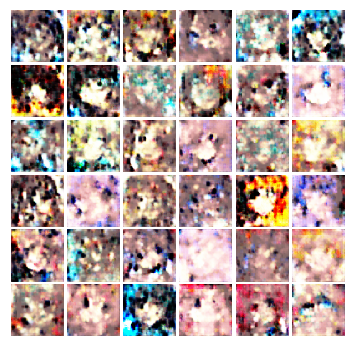


Iter:7800, D:-529.7, G:-90.53
epoch:1561---------------------------------
Iter:7805, D:-738.3, G:48.43
epoch:1562---------------------------------
Iter:7810, D:-378.3, G:77.57
epoch:1563---------------------------------
Iter:7815, D:-336.3, G:-73.1
epoch:1564---------------------------------
Iter:7820, D:-320.6, G:58.08
epoch:1565---------------------------------
Iter:7825, D:-515.1, G:-72.74
epoch:1566---------------------------------
Iter:7830, D:-352.6, G:-133.8
epoch:1567---------------------------------
Iter:7835, D:-370.8, G:-63.57
epoch:1568---------------------------------
Iter:7840, D:-718.0, G:-2.933
epoch:1569---------------------------------
Iter:7845, D:-494.7, G:-135.7
epoch:1570---------------------------------
Iter:7850, D:-519.8, G:-9.796
epoch:1571---------------------------------
Iter:7855, D:-424.1, G:-130.3
epoch:1572---------------------------------
Iter:7860, D:-553.8, G:16.66
epoch:1573---------------------------------
Iter:7865, D:-325.1, G:117.7
epoch:1574---

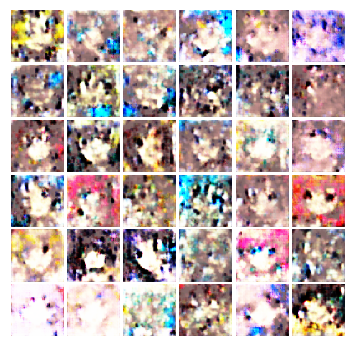


Iter:8000, D:-609.6, G:-32.76
epoch:1601---------------------------------
Iter:8005, D:-849.2, G:-21.11
epoch:1602---------------------------------
Iter:8010, D:-512.1, G:-22.76
epoch:1603---------------------------------
Iter:8015, D:-527.1, G:-114.2
epoch:1604---------------------------------
Iter:8020, D:-105.1, G:89.36
epoch:1605---------------------------------
Iter:8025, D:-430.1, G:43.34
epoch:1606---------------------------------
Iter:8030, D:-636.6, G:47.07
epoch:1607---------------------------------
Iter:8035, D:-589.7, G:13.72
epoch:1608---------------------------------
Iter:8040, D:-848.4, G:162.2
epoch:1609---------------------------------
Iter:8045, D:-120.6, G:106.9
epoch:1610---------------------------------
Iter:8050, D:-640.1, G:-102.0
epoch:1611---------------------------------
Iter:8055, D:-657.8, G:31.56
epoch:1612---------------------------------
Iter:8060, D:-635.7, G:112.6
epoch:1613---------------------------------
Iter:8065, D:-686.2, G:-180.3
epoch:1614-----

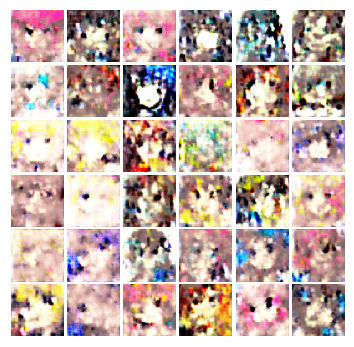


Iter:8200, D:-406.7, G:-91.9
epoch:1641---------------------------------
Iter:8205, D:-222.3, G:-221.9
epoch:1642---------------------------------
Iter:8210, D:-462.7, G:-4.341
epoch:1643---------------------------------
Iter:8215, D:-485.2, G:8.55
epoch:1644---------------------------------
Iter:8220, D:-495.2, G:51.94
epoch:1645---------------------------------
Iter:8225, D:-599.0, G:-119.5
epoch:1646---------------------------------
Iter:8230, D:-249.5, G:27.77
epoch:1647---------------------------------
Iter:8235, D:-598.1, G:125.1
epoch:1648---------------------------------
Iter:8240, D:-707.0, G:59.74
epoch:1649---------------------------------
Iter:8245, D:-572.7, G:40.56
epoch:1650---------------------------------
Iter:8250, D:-586.6, G:-36.06
epoch:1651---------------------------------
Iter:8255, D:-540.5, G:-22.25
epoch:1652---------------------------------
Iter:8260, D:-541.2, G:-21.07
epoch:1653---------------------------------
Iter:8265, D:-618.5, G:90.49
epoch:1654------

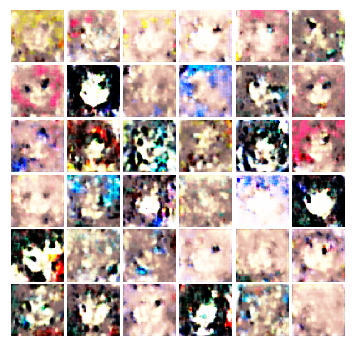


Iter:8400, D:-633.1, G:35.51
epoch:1681---------------------------------
Iter:8405, D:-214.6, G:-90.8
epoch:1682---------------------------------
Iter:8410, D:-666.9, G:-41.61
epoch:1683---------------------------------
Iter:8415, D:-720.3, G:-35.81
epoch:1684---------------------------------
Iter:8420, D:-508.5, G:65.57
epoch:1685---------------------------------
Iter:8425, D:-768.5, G:-85.01
epoch:1686---------------------------------
Iter:8430, D:-413.9, G:51.74
epoch:1687---------------------------------
Iter:8435, D:-694.7, G:50.88
epoch:1688---------------------------------
Iter:8440, D:-663.3, G:102.0
epoch:1689---------------------------------
Iter:8445, D:-221.7, G:38.19
epoch:1690---------------------------------
Iter:8450, D:-432.6, G:-5.334
epoch:1691---------------------------------
Iter:8455, D:-639.3, G:-37.61
epoch:1692---------------------------------
Iter:8460, D:-164.1, G:61.08
epoch:1693---------------------------------
Iter:8465, D:-630.5, G:-7.874
epoch:1694-----

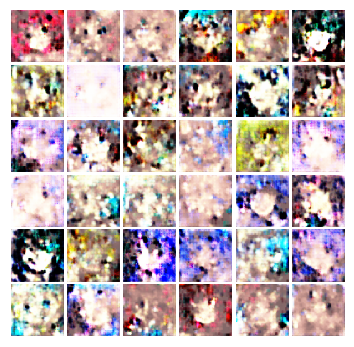


Iter:8600, D:-696.9, G:-35.58
epoch:1721---------------------------------
Iter:8605, D:-496.9, G:-124.1
epoch:1722---------------------------------
Iter:8610, D:-474.1, G:-180.8
epoch:1723---------------------------------
Iter:8615, D:-578.1, G:16.53
epoch:1724---------------------------------
Iter:8620, D:-292.2, G:22.1
epoch:1725---------------------------------
Iter:8625, D:-513.8, G:-21.06
epoch:1726---------------------------------
Iter:8630, D:-854.4, G:124.3
epoch:1727---------------------------------
Iter:8635, D:-527.9, G:-107.3
epoch:1728---------------------------------
Iter:8640, D:-866.3, G:-31.47
epoch:1729---------------------------------
Iter:8645, D:-505.7, G:-30.85
epoch:1730---------------------------------
Iter:8650, D:-463.9, G:20.53
epoch:1731---------------------------------
Iter:8655, D:-597.0, G:-0.781
epoch:1732---------------------------------
Iter:8660, D:-567.7, G:-154.7
epoch:1733---------------------------------
Iter:8665, D:-730.1, G:-10.24
epoch:1734--

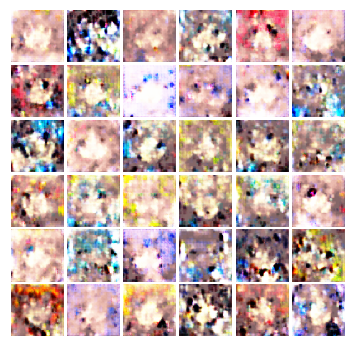


Iter:8800, D:-660.6, G:-59.93
epoch:1761---------------------------------
Iter:8805, D:-918.9, G:26.54
epoch:1762---------------------------------
Iter:8810, D:-591.0, G:76.22
epoch:1763---------------------------------
Iter:8815, D:-254.8, G:-4.58
epoch:1764---------------------------------
Iter:8820, D:-887.9, G:-203.8
epoch:1765---------------------------------
Iter:8825, D:-688.3, G:68.85
epoch:1766---------------------------------
Iter:8830, D:-686.8, G:31.18
epoch:1767---------------------------------
Iter:8835, D:-420.6, G:-100.8
epoch:1768---------------------------------
Iter:8840, D:-339.9, G:-67.8
epoch:1769---------------------------------
Iter:8845, D:-528.1, G:-49.4
epoch:1770---------------------------------
Iter:8850, D:-638.0, G:-106.6
epoch:1771---------------------------------
Iter:8855, D:-269.6, G:-62.36
epoch:1772---------------------------------
Iter:8860, D:-619.9, G:23.23
epoch:1773---------------------------------
Iter:8865, D:-342.2, G:90.28
epoch:1774------

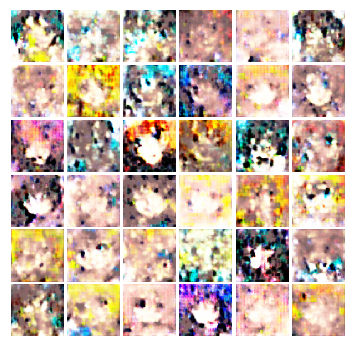


Iter:9000, D:-626.2, G:-37.65
epoch:1801---------------------------------
Iter:9005, D:-757.3, G:56.75
epoch:1802---------------------------------
Iter:9010, D:-393.0, G:20.71
epoch:1803---------------------------------
Iter:9015, D:-819.7, G:57.85
epoch:1804---------------------------------
Iter:9020, D:-620.2, G:46.11
epoch:1805---------------------------------
Iter:9025, D:-903.8, G:-82.13
epoch:1806---------------------------------
Iter:9030, D:-665.5, G:-164.1
epoch:1807---------------------------------
Iter:9035, D:-651.9, G:-44.81
epoch:1808---------------------------------
Iter:9040, D:-490.8, G:-48.79
epoch:1809---------------------------------
Iter:9045, D:1.24e+03, G:-489.5
epoch:1810---------------------------------
Iter:9050, D:-33.01, G:-41.81
epoch:1811---------------------------------
Iter:9055, D:-178.0, G:29.38
epoch:1812---------------------------------
Iter:9060, D:-233.3, G:-95.78
epoch:1813---------------------------------
Iter:9065, D:-10.71, G:-30.59
epoch:1814

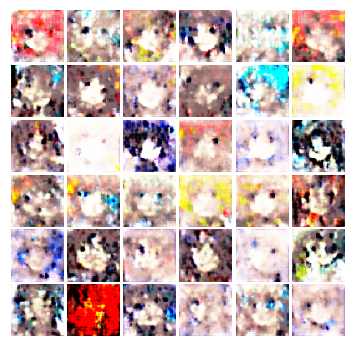


Iter:9200, D:-606.1, G:-8.334
epoch:1841---------------------------------
Iter:9205, D:-339.1, G:-77.6
epoch:1842---------------------------------
Iter:9210, D:-333.4, G:3.594
epoch:1843---------------------------------
Iter:9215, D:-343.0, G:-111.4
epoch:1844---------------------------------
Iter:9220, D:-518.0, G:-17.11
epoch:1845---------------------------------
Iter:9225, D:-341.4, G:-55.44
epoch:1846---------------------------------
Iter:9230, D:-378.0, G:-9.684
epoch:1847---------------------------------
Iter:9235, D:-532.7, G:-15.38
epoch:1848---------------------------------
Iter:9240, D:-675.9, G:-112.6
epoch:1849---------------------------------
Iter:9245, D:-496.5, G:2.882
epoch:1850---------------------------------
Iter:9250, D:-526.7, G:-6.968
epoch:1851---------------------------------
Iter:9255, D:-743.1, G:33.17
epoch:1852---------------------------------
Iter:9260, D:-675.9, G:54.61
epoch:1853---------------------------------
Iter:9265, D:-448.6, G:-7.485
epoch:1854--

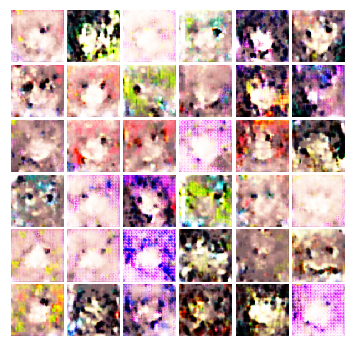


Iter:9400, D:-277.9, G:12.0
epoch:1881---------------------------------
Iter:9405, D:-45.31, G:604.1
epoch:1882---------------------------------
Iter:9410, D:-490.4, G:3.67
epoch:1883---------------------------------
Iter:9415, D:-280.7, G:-17.52
epoch:1884---------------------------------
Iter:9420, D:-910.2, G:-164.0
epoch:1885---------------------------------
Iter:9425, D:-666.0, G:2.896
epoch:1886---------------------------------
Iter:9430, D:-604.7, G:-63.77
epoch:1887---------------------------------
Iter:9435, D:-511.7, G:5.854
epoch:1888---------------------------------
Iter:9440, D:-346.8, G:-33.7
epoch:1889---------------------------------
Iter:9445, D:-459.9, G:-30.13
epoch:1890---------------------------------
Iter:9450, D:-577.9, G:-78.25
epoch:1891---------------------------------
Iter:9455, D:-444.9, G:3.806
epoch:1892---------------------------------
Iter:9460, D:1.391e+05, G:143.7
epoch:1893---------------------------------
Iter:9465, D:754.3, G:280.7
epoch:1894------

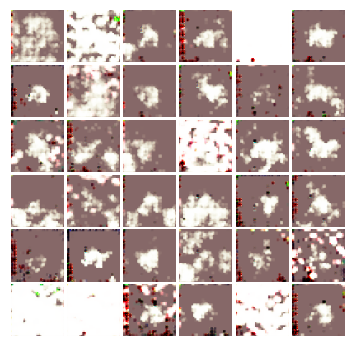


Iter:9600, D:-37.17, G:-106.3
epoch:1921---------------------------------
Iter:9605, D:-257.9, G:-93.41
epoch:1922---------------------------------
Iter:9610, D:-306.5, G:8.599
epoch:1923---------------------------------
Iter:9615, D:304.4, G:107.0
epoch:1924---------------------------------
Iter:9620, D:-150.6, G:62.18
epoch:1925---------------------------------
Iter:9625, D:-431.6, G:157.3
epoch:1926---------------------------------
Iter:9630, D:-178.8, G:80.59
epoch:1927---------------------------------
Iter:9635, D:-391.7, G:18.37
epoch:1928---------------------------------
Iter:9640, D:-167.0, G:76.72
epoch:1929---------------------------------
Iter:9645, D:-1.136e+03, G:635.9
epoch:1930---------------------------------
Iter:9650, D:-720.1, G:-14.74
epoch:1931---------------------------------
Iter:9655, D:480.0, G:310.7
epoch:1932---------------------------------
Iter:9660, D:-471.8, G:189.1
epoch:1933---------------------------------
Iter:9665, D:-167.7, G:106.6
epoch:1934------

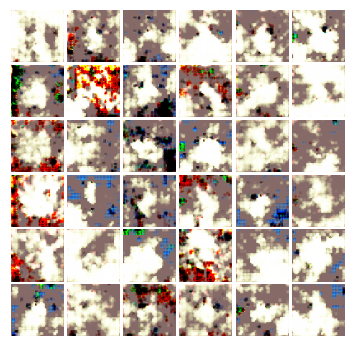


Iter:9800, D:-329.8, G:129.1
epoch:1961---------------------------------
Iter:9805, D:-217.7, G:26.54
epoch:1962---------------------------------
Iter:9810, D:-174.5, G:30.65
epoch:1963---------------------------------
Iter:9815, D:-787.4, G:522.5
epoch:1964---------------------------------
Iter:9820, D:-935.8, G:70.52
epoch:1965---------------------------------
Iter:9825, D:110.5, G:71.89
epoch:1966---------------------------------
Iter:9830, D:-270.1, G:15.5
epoch:1967---------------------------------
Iter:9835, D:-218.0, G:64.66
epoch:1968---------------------------------
Iter:9840, D:-538.5, G:60.07
epoch:1969---------------------------------
Iter:9845, D:-286.5, G:-34.55
epoch:1970---------------------------------
Iter:9850, D:-113.1, G:32.72
epoch:1971---------------------------------
Iter:9855, D:-152.2, G:122.6
epoch:1972---------------------------------
Iter:9860, D:-313.6, G:-22.7
epoch:1973---------------------------------
Iter:9865, D:-341.1, G:47.81
epoch:1974------------

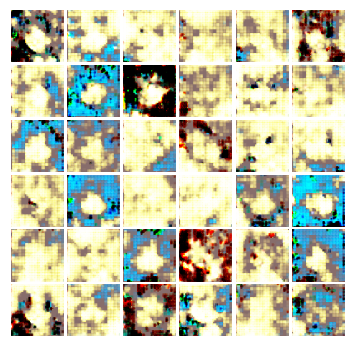


Iter:10000, D:-422.5, G:137.1
epoch:2001---------------------------------
Iter:10005, D:-307.7, G:53.48
epoch:2002---------------------------------
Iter:10010, D:-177.0, G:40.62
epoch:2003---------------------------------
Iter:10015, D:-310.3, G:28.61
epoch:2004---------------------------------
Iter:10020, D:-489.8, G:-31.06
epoch:2005---------------------------------
Iter:10025, D:-222.3, G:103.7
epoch:2006---------------------------------
Iter:10030, D:-230.0, G:68.54
epoch:2007---------------------------------
Iter:10035, D:-362.5, G:32.04
epoch:2008---------------------------------
Iter:10040, D:-400.2, G:76.88
epoch:2009---------------------------------
Iter:10045, D:-499.4, G:-20.68
epoch:2010---------------------------------
Iter:10050, D:-226.0, G:25.25
epoch:2011---------------------------------
Iter:10055, D:-445.6, G:66.52
epoch:2012---------------------------------
Iter:10060, D:-199.7, G:-73.05
epoch:2013---------------------------------
Iter:10065, D:-120.7, G:-0.05439
e

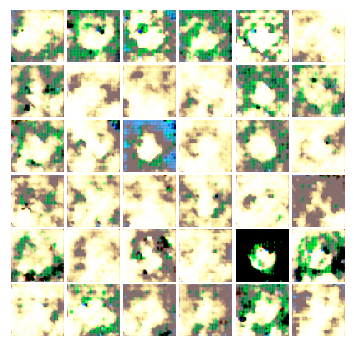


Iter:10200, D:773.5, G:189.2
epoch:2041---------------------------------
Iter:10205, D:814.9, G:64.05
epoch:2042---------------------------------
Iter:10210, D:422.4, G:114.7
epoch:2043---------------------------------
Iter:10215, D:669.3, G:109.7
epoch:2044---------------------------------
Iter:10220, D:454.1, G:68.77
epoch:2045---------------------------------
Iter:10225, D:328.3, G:7.814
epoch:2046---------------------------------
Iter:10230, D:511.9, G:-16.32
epoch:2047---------------------------------
Iter:10235, D:246.2, G:56.34
epoch:2048---------------------------------
Iter:10240, D:602.5, G:43.15
epoch:2049---------------------------------
Iter:10245, D:217.5, G:-69.09
epoch:2050---------------------------------
Iter:10250, D:132.5, G:37.54
epoch:2051---------------------------------
Iter:10255, D:375.9, G:123.7
epoch:2052---------------------------------
Iter:10260, D:214.3, G:127.8
epoch:2053---------------------------------
Iter:10265, D:-4.873, G:63.9
epoch:2054---------

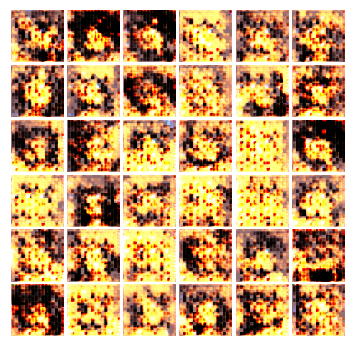


Iter:10400, D:1.189e+03, G:340.1
epoch:2081---------------------------------
Iter:10405, D:760.2, G:834.4
epoch:2082---------------------------------
Iter:10410, D:382.9, G:1.137e+03
epoch:2083---------------------------------
Iter:10415, D:93.73, G:758.0
epoch:2084---------------------------------
Iter:10420, D:8.056, G:685.7
epoch:2085---------------------------------
Iter:10425, D:147.0, G:396.3
epoch:2086---------------------------------
Iter:10430, D:104.5, G:448.4
epoch:2087---------------------------------
Iter:10435, D:133.8, G:512.2
epoch:2088---------------------------------
Iter:10440, D:-775.9, G:932.7
epoch:2089---------------------------------
Iter:10445, D:-1.408e+03, G:801.6
epoch:2090---------------------------------
Iter:10450, D:-419.1, G:-626.3
epoch:2091---------------------------------
Iter:10455, D:-489.8, G:59.51
epoch:2092---------------------------------
Iter:10460, D:-625.9, G:348.2
epoch:2093---------------------------------
Iter:10465, D:-1.515e+03, G:363.

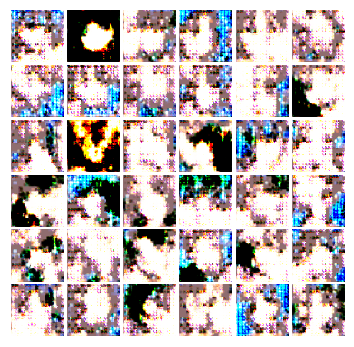


Iter:10600, D:67.45, G:86.35
epoch:2121---------------------------------
Iter:10605, D:567.0, G:227.9
epoch:2122---------------------------------
Iter:10610, D:-13.08, G:107.2
epoch:2123---------------------------------
Iter:10615, D:152.3, G:89.67
epoch:2124---------------------------------
Iter:10620, D:145.3, G:202.3
epoch:2125---------------------------------
Iter:10625, D:186.6, G:222.6
epoch:2126---------------------------------
Iter:10630, D:426.6, G:102.1
epoch:2127---------------------------------
Iter:10635, D:45.02, G:80.28
epoch:2128---------------------------------
Iter:10640, D:-99.2, G:-28.37
epoch:2129---------------------------------
Iter:10645, D:424.1, G:228.3
epoch:2130---------------------------------
Iter:10650, D:54.68, G:32.02
epoch:2131---------------------------------
Iter:10655, D:53.46, G:72.15
epoch:2132---------------------------------
Iter:10660, D:-11.21, G:86.98
epoch:2133---------------------------------
Iter:10665, D:93.16, G:70.33
epoch:2134--------

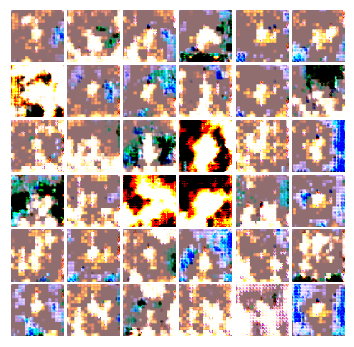


Iter:10800, D:112.4, G:-10.04
epoch:2161---------------------------------
Iter:10805, D:137.3, G:50.06
epoch:2162---------------------------------
Iter:10810, D:-43.72, G:183.3
epoch:2163---------------------------------
Iter:10815, D:66.02, G:62.82
epoch:2164---------------------------------
Iter:10820, D:72.34, G:166.6
epoch:2165---------------------------------
Iter:10825, D:-77.6, G:160.8
epoch:2166---------------------------------
Iter:10830, D:61.4, G:236.7
epoch:2167---------------------------------
Iter:10835, D:293.6, G:409.2
epoch:2168---------------------------------
Iter:10840, D:258.4, G:1.561
epoch:2169---------------------------------
Iter:10845, D:-119.4, G:252.0
epoch:2170---------------------------------
Iter:10850, D:-75.67, G:74.3
epoch:2171---------------------------------
Iter:10855, D:486.3, G:112.0
epoch:2172---------------------------------
Iter:10860, D:4.581, G:152.2
epoch:2173---------------------------------
Iter:10865, D:-60.29, G:199.3
epoch:2174--------

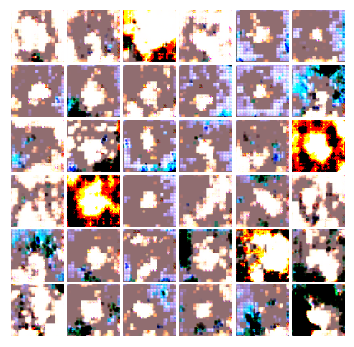


Iter:11000, D:182.1, G:37.58
epoch:2201---------------------------------
Iter:11005, D:237.6, G:78.68
epoch:2202---------------------------------
Iter:11010, D:296.6, G:26.9
epoch:2203---------------------------------
Iter:11015, D:226.1, G:30.03
epoch:2204---------------------------------
Iter:11020, D:120.6, G:95.7
epoch:2205---------------------------------
Iter:11025, D:188.8, G:-34.98
epoch:2206---------------------------------
Iter:11030, D:243.6, G:13.66
epoch:2207---------------------------------
Iter:11035, D:332.2, G:-18.09
epoch:2208---------------------------------
Iter:11040, D:198.6, G:182.8
epoch:2209---------------------------------
Iter:11045, D:158.8, G:92.94
epoch:2210---------------------------------
Iter:11050, D:188.6, G:3.725
epoch:2211---------------------------------
Iter:11055, D:168.8, G:74.81
epoch:2212---------------------------------
Iter:11060, D:137.3, G:463.8
epoch:2213---------------------------------
Iter:11065, D:178.8, G:290.7
epoch:2214-----------

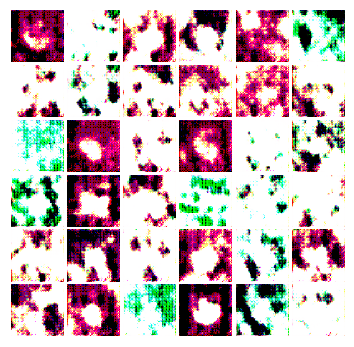


Iter:11200, D:69.4, G:333.2
epoch:2241---------------------------------
Iter:11205, D:-43.12, G:572.0
epoch:2242---------------------------------
Iter:11210, D:363.6, G:384.2
epoch:2243---------------------------------
Iter:11215, D:-42.86, G:611.1
epoch:2244---------------------------------
Iter:11220, D:333.3, G:217.8
epoch:2245---------------------------------
Iter:11225, D:296.2, G:467.5
epoch:2246---------------------------------
Iter:11230, D:-62.07, G:410.6
epoch:2247---------------------------------
Iter:11235, D:379.8, G:345.9
epoch:2248---------------------------------
Iter:11240, D:201.2, G:420.0
epoch:2249---------------------------------
Iter:11245, D:45.84, G:511.7
epoch:2250---------------------------------
Iter:11250, D:57.35, G:403.7
epoch:2251---------------------------------
Iter:11255, D:55.76, G:137.0
epoch:2252---------------------------------
Iter:11260, D:105.6, G:509.7
epoch:2253---------------------------------
Iter:11265, D:20.55, G:319.1
epoch:2254---------

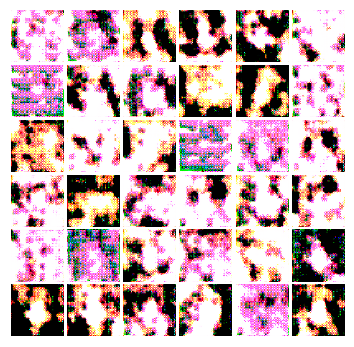


Iter:11400, D:24.68, G:465.7
epoch:2281---------------------------------
Iter:11405, D:-104.9, G:384.5
epoch:2282---------------------------------
Iter:11410, D:27.24, G:7.475
epoch:2283---------------------------------
Iter:11415, D:-19.73, G:374.5
epoch:2284---------------------------------
Iter:11420, D:137.6, G:229.3
epoch:2285---------------------------------
Iter:11425, D:15.79, G:119.4
epoch:2286---------------------------------
Iter:11430, D:148.9, G:308.8
epoch:2287---------------------------------
Iter:11435, D:76.61, G:247.6
epoch:2288---------------------------------
Iter:11440, D:117.7, G:448.0
epoch:2289---------------------------------
Iter:11445, D:185.3, G:168.4
epoch:2290---------------------------------
Iter:11450, D:-13.1, G:333.9
epoch:2291---------------------------------
Iter:11455, D:60.92, G:375.9
epoch:2292---------------------------------
Iter:11460, D:138.1, G:294.7
epoch:2293---------------------------------
Iter:11465, D:43.23, G:332.4
epoch:2294---------

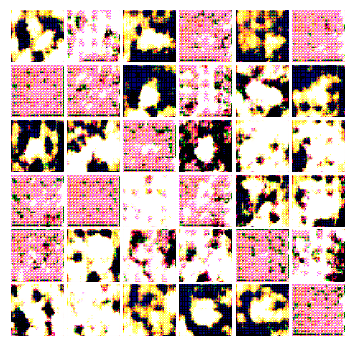


Iter:11600, D:203.3, G:231.9
epoch:2321---------------------------------
Iter:11605, D:61.03, G:281.7
epoch:2322---------------------------------
Iter:11610, D:4.202, G:451.3
epoch:2323---------------------------------
Iter:11615, D:4.026, G:433.7
epoch:2324---------------------------------
Iter:11620, D:196.9, G:406.9
epoch:2325---------------------------------
Iter:11625, D:34.07, G:259.3
epoch:2326---------------------------------
Iter:11630, D:79.88, G:324.7
epoch:2327---------------------------------
Iter:11635, D:-70.23, G:691.0
epoch:2328---------------------------------
Iter:11640, D:2.242, G:380.0
epoch:2329---------------------------------
Iter:11645, D:130.9, G:271.8
epoch:2330---------------------------------
Iter:11650, D:-81.76, G:246.3
epoch:2331---------------------------------
Iter:11655, D:-78.8, G:241.9
epoch:2332---------------------------------
Iter:11660, D:101.6, G:487.3
epoch:2333---------------------------------
Iter:11665, D:-129.7, G:418.1
epoch:2334--------

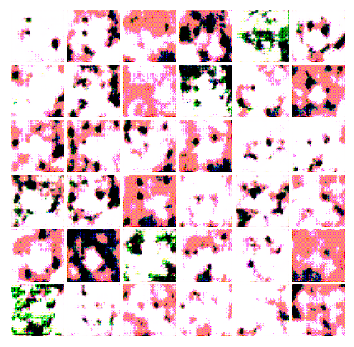


Iter:11800, D:-103.5, G:438.4
epoch:2361---------------------------------
Iter:11805, D:48.13, G:63.54
epoch:2362---------------------------------
Iter:11810, D:-70.59, G:380.2
epoch:2363---------------------------------
Iter:11815, D:-1.945, G:480.5
epoch:2364---------------------------------
Iter:11820, D:-77.49, G:205.3
epoch:2365---------------------------------
Iter:11825, D:180.7, G:87.37
epoch:2366---------------------------------
Iter:11830, D:203.3, G:511.2
epoch:2367---------------------------------
Iter:11835, D:-68.52, G:587.3
epoch:2368---------------------------------
Iter:11840, D:209.2, G:167.2
epoch:2369---------------------------------
Iter:11845, D:-98.04, G:143.4
epoch:2370---------------------------------
Iter:11850, D:-20.39, G:539.2
epoch:2371---------------------------------
Iter:11855, D:-142.3, G:453.9
epoch:2372---------------------------------
Iter:11860, D:-2.652, G:483.2
epoch:2373---------------------------------
Iter:11865, D:261.7, G:93.07
epoch:2374--

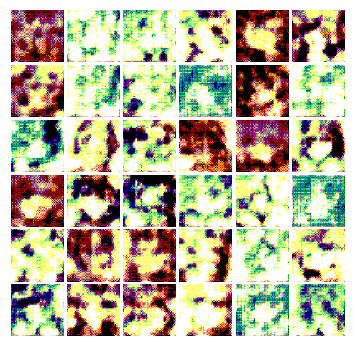


Iter:12000, D:-41.33, G:274.0
epoch:2401---------------------------------
Iter:12005, D:7.001, G:150.3
epoch:2402---------------------------------
Iter:12010, D:383.2, G:94.51
epoch:2403---------------------------------
Iter:12015, D:-109.8, G:162.4
epoch:2404---------------------------------
Iter:12020, D:-54.03, G:322.7
epoch:2405---------------------------------
Iter:12025, D:-226.6, G:142.9
epoch:2406---------------------------------
Iter:12030, D:-7.171, G:308.2
epoch:2407---------------------------------
Iter:12035, D:-78.56, G:305.2
epoch:2408---------------------------------
Iter:12040, D:-15.28, G:339.3
epoch:2409---------------------------------
Iter:12045, D:86.53, G:256.6
epoch:2410---------------------------------
Iter:12050, D:-117.8, G:100.5
epoch:2411---------------------------------
Iter:12055, D:-121.3, G:446.0
epoch:2412---------------------------------
Iter:12060, D:-13.69, G:246.2
epoch:2413---------------------------------
Iter:12065, D:22.02, G:5.632
epoch:2414-

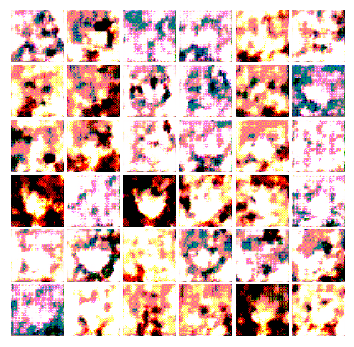


Iter:12200, D:-291.3, G:316.0
epoch:2441---------------------------------
Iter:12205, D:-289.4, G:366.2
epoch:2442---------------------------------
Iter:12210, D:130.8, G:205.2
epoch:2443---------------------------------
Iter:12215, D:189.3, G:153.6
epoch:2444---------------------------------
Iter:12220, D:139.9, G:82.66
epoch:2445---------------------------------
Iter:12225, D:-106.4, G:433.6
epoch:2446---------------------------------
Iter:12230, D:-4.787, G:336.0
epoch:2447---------------------------------
Iter:12235, D:-258.8, G:188.4
epoch:2448---------------------------------
Iter:12240, D:33.03, G:171.0
epoch:2449---------------------------------
Iter:12245, D:-201.8, G:136.3
epoch:2450---------------------------------
Iter:12250, D:228.3, G:199.1
epoch:2451---------------------------------
Iter:12255, D:-117.2, G:572.6
epoch:2452---------------------------------
Iter:12260, D:-121.4, G:397.9
epoch:2453---------------------------------
Iter:12265, D:-110.6, G:236.5
epoch:2454--

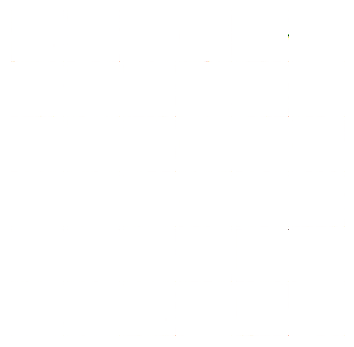


Iter:12400, D:-4.781e+03, G:1.796e+03
epoch:2481---------------------------------
Iter:12405, D:3.636e+03, G:24.36
epoch:2482---------------------------------
Iter:12410, D:-7.198e+03, G:828.3
epoch:2483---------------------------------
Iter:12415, D:-7.161e+03, G:3.527e+03
epoch:2484---------------------------------
Iter:12420, D:-3.835e+03, G:446.3
epoch:2485---------------------------------
Iter:12425, D:-1.196e+04, G:571.1
epoch:2486---------------------------------
Iter:12430, D:-1.196e+04, G:2.118e+03
epoch:2487---------------------------------
Iter:12435, D:-6.465e+03, G:610.2
epoch:2488---------------------------------
Iter:12440, D:-1.029e+04, G:841.7
epoch:2489---------------------------------
Iter:12445, D:-1.025e+04, G:2.348e+03
epoch:2490---------------------------------
Iter:12450, D:-9.977e+03, G:1.332e+03
epoch:2491---------------------------------
Iter:12455, D:-1.059e+04, G:-81.76
epoch:2492---------------------------------
Iter:12460, D:-9.553e+03, G:4.841e+03
epoch

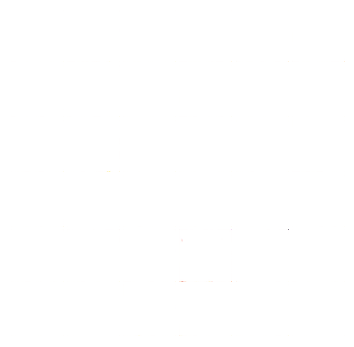


Iter:12600, D:-2.376e+04, G:1.79e+03
epoch:2521---------------------------------
Iter:12605, D:-4.835e+04, G:698.5
epoch:2522---------------------------------
Iter:12610, D:-4.488e+04, G:2.1e+03
epoch:2523---------------------------------
Iter:12615, D:-2.27e+04, G:-20.37
epoch:2524---------------------------------
Iter:12620, D:-3.876e+04, G:-1.008e+03
epoch:2525---------------------------------
Iter:12625, D:-4.223e+04, G:4.752e+03
epoch:2526---------------------------------
Iter:12630, D:-5.748e+04, G:-1.151e+03
epoch:2527---------------------------------
Iter:12635, D:-4.302e+04, G:-1.482e+03
epoch:2528---------------------------------
Iter:12640, D:-3.715e+04, G:124.0
epoch:2529---------------------------------
Iter:12645, D:-5.335e+04, G:4.817e+03
epoch:2530---------------------------------
Iter:12650, D:-5.598e+04, G:1.063e+03
epoch:2531---------------------------------
Iter:12655, D:-5.89e+04, G:1.1e+03
epoch:2532---------------------------------
Iter:12660, D:-5.367e+04, G:-2

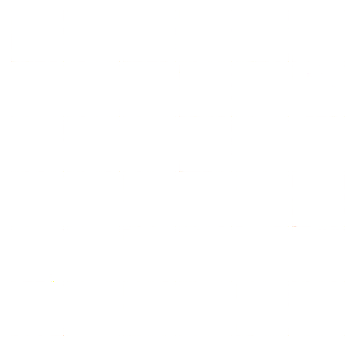


Iter:12800, D:-7.59e+04, G:1.419e+03
epoch:2561---------------------------------
Iter:12805, D:-1.016e+05, G:601.4
epoch:2562---------------------------------
Iter:12810, D:-3.662e+04, G:-4.096e+03
epoch:2563---------------------------------
Iter:12815, D:-1.754e+05, G:1.212e+03
epoch:2564---------------------------------
Iter:12820, D:-9.328e+04, G:1.554e+03
epoch:2565---------------------------------
Iter:12825, D:-3.693e+04, G:1.13e+04
epoch:2566---------------------------------
Iter:12830, D:5.197e+04, G:-802.4
epoch:2567---------------------------------
Iter:12835, D:-1.167e+05, G:1.076e+03
epoch:2568---------------------------------
Iter:12840, D:-1.3e+05, G:35.95
epoch:2569---------------------------------
Iter:12845, D:-7.263e+04, G:26.09
epoch:2570---------------------------------
Iter:12850, D:-1.351e+05, G:239.1
epoch:2571---------------------------------
Iter:12855, D:-1.095e+05, G:1.348e+03
epoch:2572---------------------------------
Iter:12860, D:-1.152e+05, G:-69.22
epo

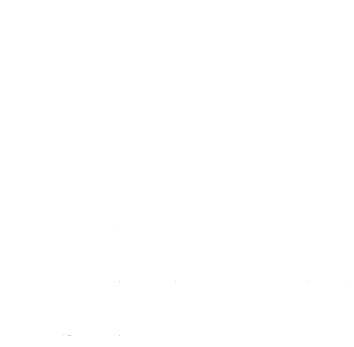


Iter:13000, D:-2.462e+05, G:990.2
epoch:2601---------------------------------
Iter:13005, D:-1.725e+05, G:6.186e+03
epoch:2602---------------------------------
Iter:13010, D:-9.639e+04, G:65.73
epoch:2603---------------------------------
Iter:13015, D:-1.272e+05, G:-399.0
epoch:2604---------------------------------
Iter:13020, D:-1.464e+05, G:4.501e+03
epoch:2605---------------------------------
Iter:13025, D:-1.22e+05, G:-4.427e+03
epoch:2606---------------------------------
Iter:13030, D:-1.918e+05, G:-438.2
epoch:2607---------------------------------
Iter:13035, D:-1.183e+05, G:-180.6
epoch:2608---------------------------------
Iter:13040, D:-1.242e+05, G:1.511e+03
epoch:2609---------------------------------
Iter:13045, D:-1.71e+05, G:2.288e+03
epoch:2610---------------------------------
Iter:13050, D:-1.585e+05, G:-906.2
epoch:2611---------------------------------
Iter:13055, D:-2.29e+05, G:1.004e+03
epoch:2612---------------------------------
Iter:13060, D:-1.518e+05, G:-1.279e+0

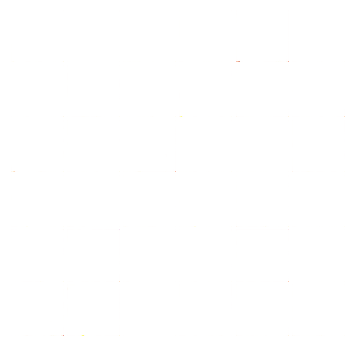


Iter:13200, D:-1.929e+05, G:815.6
epoch:2641---------------------------------
Iter:13205, D:-3.691e+05, G:-395.1
epoch:2642---------------------------------
Iter:13210, D:1.08e+06, G:-231.4
epoch:2643---------------------------------
Iter:13215, D:-1.192e+05, G:3.268e+03
epoch:2644---------------------------------
Iter:13220, D:-2.198e+05, G:79.34
epoch:2645---------------------------------
Iter:13225, D:-2.946e+05, G:413.2
epoch:2646---------------------------------
Iter:13230, D:-2.109e+05, G:3.904e+03
epoch:2647---------------------------------
Iter:13235, D:-1.66e+05, G:1.158e+03
epoch:2648---------------------------------
Iter:13240, D:-2.681e+05, G:2.098e+03
epoch:2649---------------------------------
Iter:13245, D:-2e+05, G:5.452e+03
epoch:2650---------------------------------
Iter:13250, D:-3.196e+05, G:-1.555e+03
epoch:2651---------------------------------
Iter:13255, D:-2.82e+05, G:2.061e+03
epoch:2652---------------------------------
Iter:13260, D:-2.798e+05, G:-427.7
epoch

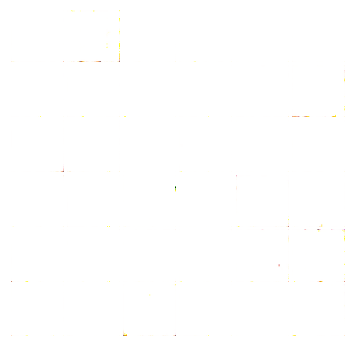


Iter:13400, D:-2.137e+05, G:-94.24
epoch:2681---------------------------------
Iter:13405, D:-4.622e+05, G:-260.8
epoch:2682---------------------------------
Iter:13410, D:-3.694e+05, G:-151.4
epoch:2683---------------------------------
Iter:13415, D:-2.646e+05, G:-1.237e+03
epoch:2684---------------------------------
Iter:13420, D:3.21e+09, G:-8.709e+05
epoch:2685---------------------------------
Iter:13425, D:1.43e+08, G:6.749e+04
epoch:2686---------------------------------
Iter:13430, D:1.455e+07, G:-9.027e+03
epoch:2687---------------------------------
Iter:13435, D:7.824e+06, G:-3.125e+03
epoch:2688---------------------------------
Iter:13440, D:3.381e+06, G:1.021e+03
epoch:2689---------------------------------
Iter:13445, D:6.382e+06, G:-2.068e+03
epoch:2690---------------------------------
Iter:13450, D:8.046e+06, G:6.023e+03
epoch:2691---------------------------------
Iter:13455, D:3.679e+06, G:7.336e+03
epoch:2692---------------------------------
Iter:13460, D:4.145e+06, G:4.

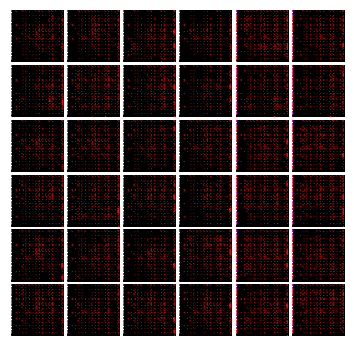


Iter:13600, D:7.163e+05, G:1.026e+04
epoch:2721---------------------------------
Iter:13605, D:2.567e+06, G:-7.273e+04
epoch:2722---------------------------------
Iter:13610, D:4.495e+06, G:1.042e+04
epoch:2723---------------------------------
Iter:13615, D:2.609e+06, G:5.85e+03
epoch:2724---------------------------------
Iter:13620, D:6.113e+06, G:-2.685e+03
epoch:2725---------------------------------
Iter:13625, D:3.04e+06, G:4.301e+03
epoch:2726---------------------------------
Iter:13630, D:1.876e+06, G:2.15e+03
epoch:2727---------------------------------
Iter:13635, D:2.038e+06, G:-591.7
epoch:2728---------------------------------
Iter:13640, D:2.247e+06, G:1.323e+03
epoch:2729---------------------------------
Iter:13645, D:4.628e+06, G:7.818e+03
epoch:2730---------------------------------
Iter:13650, D:3.397e+06, G:-2.2e+03
epoch:2731---------------------------------
Iter:13655, D:1.916e+06, G:4.647e+03
epoch:2732---------------------------------
Iter:13660, D:2.927e+06, G:7.104

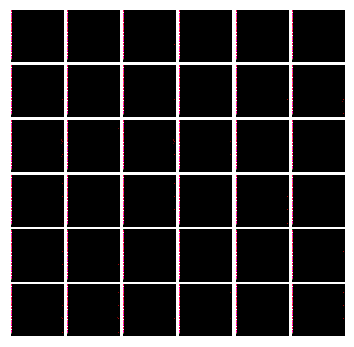


Iter:13800, D:1.163e+08, G:3.56e+04
epoch:2761---------------------------------
Iter:13805, D:1.7e+07, G:2.622e+04
epoch:2762---------------------------------
Iter:13810, D:3.489e+06, G:1.425e+04
epoch:2763---------------------------------
Iter:13815, D:7.316e+06, G:1.245e+04
epoch:2764---------------------------------
Iter:13820, D:2.913e+06, G:1.694e+03
epoch:2765---------------------------------
Iter:13825, D:3.161e+06, G:1.624e+03
epoch:2766---------------------------------
Iter:13830, D:2.66e+06, G:3.134e+03
epoch:2767---------------------------------
Iter:13835, D:1.593e+06, G:-1.399e+03
epoch:2768---------------------------------
Iter:13840, D:1.342e+06, G:5.611e+03
epoch:2769---------------------------------
Iter:13845, D:2.784e+06, G:7.836e+03
epoch:2770---------------------------------
Iter:13850, D:5.497e+06, G:2.168e+04
epoch:2771---------------------------------
Iter:13855, D:2.24e+06, G:6.725e+03
epoch:2772---------------------------------
Iter:13860, D:2.318e+06, G:-137

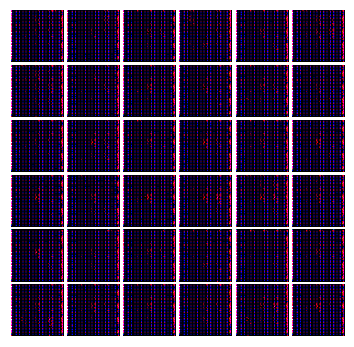


Iter:14000, D:1.542e+06, G:3.659e+03
epoch:2801---------------------------------
Iter:14005, D:1.792e+06, G:8.231e+03
epoch:2802---------------------------------
Iter:14010, D:5.398e+06, G:8.57e+03
epoch:2803---------------------------------
Iter:14015, D:2.185e+06, G:4.006e+03
epoch:2804---------------------------------
Iter:14020, D:1.64e+06, G:1.374e+04
epoch:2805---------------------------------
Iter:14025, D:1.477e+06, G:2.444e+03
epoch:2806---------------------------------
Iter:14030, D:6.315e+06, G:-9.735e+03
epoch:2807---------------------------------
Iter:14035, D:1.894e+06, G:-2.916e+03
epoch:2808---------------------------------
Iter:14040, D:2.428e+06, G:5.882e+03
epoch:2809---------------------------------
Iter:14045, D:2.358e+06, G:4.23e+03
epoch:2810---------------------------------
Iter:14050, D:1.633e+06, G:1.739e+03
epoch:2811---------------------------------
Iter:14055, D:6.933e+05, G:1.261e+03
epoch:2812---------------------------------
Iter:14060, D:2.168e+06, G:7

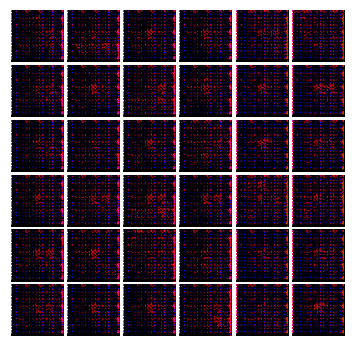


Iter:14200, D:5.182e+06, G:1.185e+03
epoch:2841---------------------------------
Iter:14205, D:1.332e+06, G:515.1
epoch:2842---------------------------------
Iter:14210, D:2.224e+06, G:4.94e+03
epoch:2843---------------------------------
Iter:14215, D:1.674e+06, G:5.985e+03
epoch:2844---------------------------------
Iter:14220, D:6.867e+05, G:4.727e+03
epoch:2845---------------------------------
Iter:14225, D:2.585e+06, G:1.048e+04
epoch:2846---------------------------------
Iter:14230, D:2.049e+06, G:-6.06e+03
epoch:2847---------------------------------
Iter:14235, D:1.368e+06, G:1.075e+03
epoch:2848---------------------------------
Iter:14240, D:1.427e+06, G:7.558e+03
epoch:2849---------------------------------
Iter:14245, D:7.517e+05, G:1.915e+03
epoch:2850---------------------------------
Iter:14250, D:5.884e+05, G:2.037e+03
epoch:2851---------------------------------
Iter:14255, D:3.174e+06, G:1.084e+04
epoch:2852---------------------------------
Iter:14260, D:7.047e+05, G:-31.1

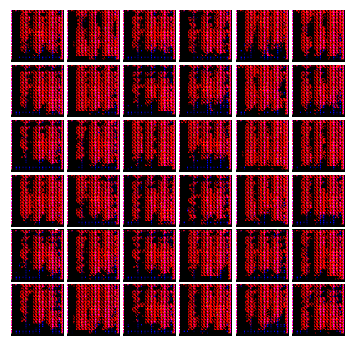


Iter:14400, D:1.55e+06, G:1.288e+03
epoch:2881---------------------------------
Iter:14405, D:1.358e+06, G:9.131e+03
epoch:2882---------------------------------
Iter:14410, D:1.262e+06, G:4.463e+03
epoch:2883---------------------------------
Iter:14415, D:1.948e+06, G:-6.337e+03
epoch:2884---------------------------------
Iter:14420, D:1.013e+06, G:3.33e+03
epoch:2885---------------------------------
Iter:14425, D:1.69e+06, G:9.813e+03
epoch:2886---------------------------------
Iter:14430, D:1.52e+06, G:754.1
epoch:2887---------------------------------
Iter:14435, D:1.431e+06, G:6.61e+03
epoch:2888---------------------------------
Iter:14440, D:1.424e+06, G:521.2
epoch:2889---------------------------------
Iter:14445, D:1.307e+06, G:7.722e+03
epoch:2890---------------------------------
Iter:14450, D:1.119e+06, G:3.403e+03
epoch:2891---------------------------------
Iter:14455, D:8.737e+05, G:2.404e+03
epoch:2892---------------------------------
Iter:14460, D:2.35e+06, G:-3.039e+03
ep

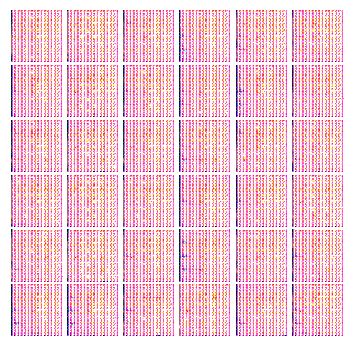


Iter:14600, D:8.279e+04, G:423.0
epoch:2921---------------------------------
Iter:14605, D:7.432e+04, G:1.006e+03
epoch:2922---------------------------------
Iter:14610, D:8.898e+04, G:292.4
epoch:2923---------------------------------
Iter:14615, D:5.827e+04, G:917.6
epoch:2924---------------------------------
Iter:14620, D:6.45e+04, G:634.1
epoch:2925---------------------------------
Iter:14625, D:5.148e+04, G:796.5
epoch:2926---------------------------------
Iter:14630, D:7.221e+04, G:899.1
epoch:2927---------------------------------
Iter:14635, D:5.234e+04, G:680.4
epoch:2928---------------------------------
Iter:14640, D:6.094e+04, G:442.8
epoch:2929---------------------------------
Iter:14645, D:6.18e+04, G:640.3
epoch:2930---------------------------------
Iter:14650, D:4.727e+04, G:808.0
epoch:2931---------------------------------
Iter:14655, D:7.178e+04, G:488.9
epoch:2932---------------------------------
Iter:14660, D:6.655e+04, G:152.4
epoch:2933------------------------------

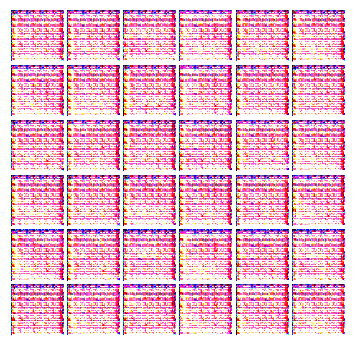


Iter:14800, D:9.8e+04, G:2.028e+03
epoch:2961---------------------------------
Iter:14805, D:7.69e+04, G:291.1
epoch:2962---------------------------------
Iter:14810, D:6.7e+04, G:851.5
epoch:2963---------------------------------
Iter:14815, D:5.16e+04, G:355.4
epoch:2964---------------------------------
Iter:14820, D:6.294e+04, G:707.5
epoch:2965---------------------------------
Iter:14825, D:5.824e+04, G:475.7
epoch:2966---------------------------------
Iter:14830, D:6.18e+04, G:719.8
epoch:2967---------------------------------
Iter:14835, D:5.695e+04, G:575.5
epoch:2968---------------------------------
Iter:14840, D:5.918e+04, G:629.4
epoch:2969---------------------------------
Iter:14845, D:6.281e+04, G:594.3
epoch:2970---------------------------------
Iter:14850, D:5.08e+04, G:483.6
epoch:2971---------------------------------
Iter:14855, D:4.71e+04, G:495.0
epoch:2972---------------------------------
Iter:14860, D:4.198e+04, G:714.6
epoch:2973---------------------------------
Ite

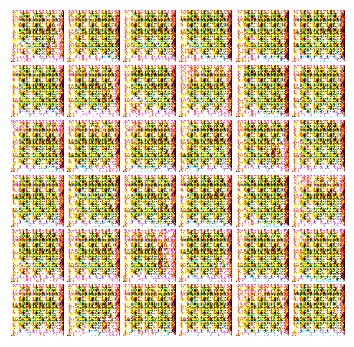


Iter:15000, D:7.588e+04, G:290.7
epoch:3001---------------------------------
Iter:15005, D:4.272e+04, G:87.86
epoch:3002---------------------------------
Iter:15010, D:6.451e+04, G:358.6
epoch:3003---------------------------------
Iter:15015, D:3.764e+04, G:363.7
epoch:3004---------------------------------
Iter:15020, D:4.305e+04, G:276.0
epoch:3005---------------------------------
Iter:15025, D:3.829e+04, G:231.6
epoch:3006---------------------------------
Iter:15030, D:4.47e+04, G:165.3
epoch:3007---------------------------------
Iter:15035, D:4.968e+04, G:248.3
epoch:3008---------------------------------
Iter:15040, D:4.792e+04, G:309.1
epoch:3009---------------------------------
Iter:15045, D:3.789e+04, G:61.23
epoch:3010---------------------------------
Iter:15050, D:5.317e+04, G:401.8
epoch:3011---------------------------------
Iter:15055, D:4.646e+04, G:427.6
epoch:3012---------------------------------
Iter:15060, D:5.102e+04, G:515.3
epoch:3013---------------------------------

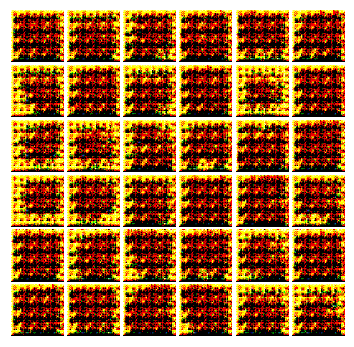


Iter:15200, D:2.367e+06, G:-547.0
epoch:3041---------------------------------
Iter:15205, D:2.14e+06, G:-8.238e+03
epoch:3042---------------------------------
Iter:15210, D:2.438e+06, G:5.802e+03
epoch:3043---------------------------------
Iter:15215, D:1.664e+06, G:6.002e+03
epoch:3044---------------------------------
Iter:15220, D:5.688e+07, G:-2.367e+03
epoch:3045---------------------------------
Iter:15225, D:2.894e+06, G:-6.628e+03
epoch:3046---------------------------------
Iter:15230, D:8.017e+05, G:-1.347e+03
epoch:3047---------------------------------
Iter:15235, D:1.301e+06, G:944.8
epoch:3048---------------------------------
Iter:15240, D:6.779e+05, G:2.175e+03
epoch:3049---------------------------------
Iter:15245, D:6.696e+05, G:4.318e+03
epoch:3050---------------------------------
Iter:15250, D:6.699e+05, G:-2.161e+03
epoch:3051---------------------------------
Iter:15255, D:4.899e+05, G:5.269e+03
epoch:3052---------------------------------
Iter:15260, D:1.043e+06, G:4.6

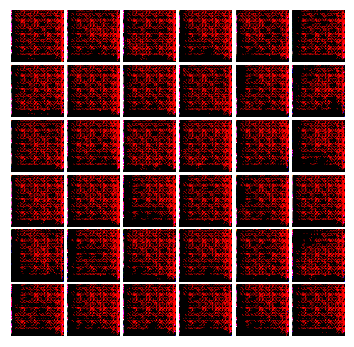


Iter:15400, D:9.14e+05, G:-4.003e+03
epoch:3081---------------------------------
Iter:15405, D:1.094e+06, G:-4.571e+03
epoch:3082---------------------------------
Iter:15410, D:9.03e+05, G:7.957e+03
epoch:3083---------------------------------
Iter:15415, D:6.841e+05, G:3.864e+03
epoch:3084---------------------------------
Iter:15420, D:2.796e+05, G:2.053e+03
epoch:3085---------------------------------
Iter:15425, D:4.675e+05, G:-991.2
epoch:3086---------------------------------
Iter:15430, D:5.012e+05, G:4.559e+03
epoch:3087---------------------------------
Iter:15435, D:4.642e+05, G:3.044e+03
epoch:3088---------------------------------
Iter:15440, D:2.443e+06, G:1.027e+04
epoch:3089---------------------------------
Iter:15445, D:6.046e+05, G:2.11e+03
epoch:3090---------------------------------
Iter:15450, D:4.115e+05, G:2.693e+03
epoch:3091---------------------------------
Iter:15455, D:6.301e+05, G:2.306e+03
epoch:3092---------------------------------
Iter:15460, D:1.071e+06, G:-318

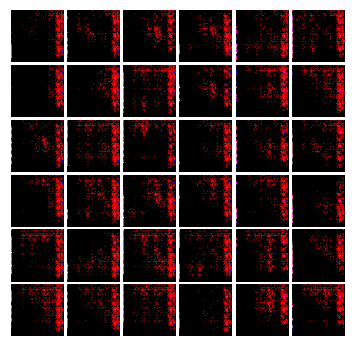


Iter:15600, D:8.454e+05, G:-3.461e+03
epoch:3121---------------------------------
Iter:15605, D:3.038e+05, G:2.99e+03
epoch:3122---------------------------------
Iter:15610, D:4.014e+05, G:9.426e+03
epoch:3123---------------------------------
Iter:15615, D:5.394e+05, G:-1.513e+03
epoch:3124---------------------------------
Iter:15620, D:5.676e+05, G:2.003e+03
epoch:3125---------------------------------
Iter:15625, D:1.305e+06, G:7.262e+03
epoch:3126---------------------------------
Iter:15630, D:7.806e+05, G:-2.84e+03
epoch:3127---------------------------------
Iter:15635, D:7.121e+05, G:5.69e+03
epoch:3128---------------------------------
Iter:15640, D:4.649e+05, G:6.578e+03
epoch:3129---------------------------------
Iter:15645, D:1.298e+06, G:-3.604e+03
epoch:3130---------------------------------
Iter:15650, D:9.685e+05, G:1.924e+03
epoch:3131---------------------------------
Iter:15655, D:1.801e+06, G:8.88e+03
epoch:3132---------------------------------
Iter:15660, D:7.161e+05, G:

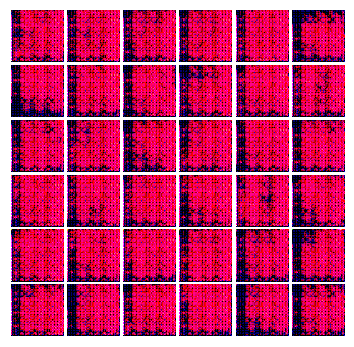


Iter:15800, D:4.42e+06, G:6.838e+03
epoch:3161---------------------------------
Iter:15805, D:1.848e+06, G:-353.7
epoch:3162---------------------------------
Iter:15810, D:2.607e+06, G:-504.2
epoch:3163---------------------------------
Iter:15815, D:1.732e+06, G:1.309e+03
epoch:3164---------------------------------
Iter:15820, D:2.244e+06, G:4.339e+03
epoch:3165---------------------------------
Iter:15825, D:1.229e+06, G:1.122e+03
epoch:3166---------------------------------
Iter:15830, D:2.209e+06, G:5.911e+03
epoch:3167---------------------------------
Iter:15835, D:2.642e+06, G:3.417e+03
epoch:3168---------------------------------
Iter:15840, D:1.511e+06, G:2.089e+03
epoch:3169---------------------------------
Iter:15845, D:1.363e+06, G:1.464e+03
epoch:3170---------------------------------
Iter:15850, D:1.541e+06, G:4.225e+03
epoch:3171---------------------------------
Iter:15855, D:1.355e+06, G:1.688e+03
epoch:3172---------------------------------
Iter:15860, D:nan, G:nan
epoch:317

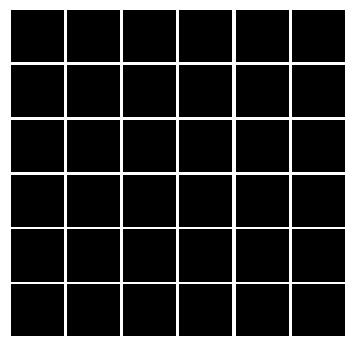


Iter:16000, D:nan, G:nan
epoch:3201---------------------------------
Iter:16005, D:nan, G:nan
epoch:3202---------------------------------
Iter:16010, D:nan, G:nan
epoch:3203---------------------------------
Iter:16015, D:nan, G:nan
epoch:3204---------------------------------
Iter:16020, D:nan, G:nan
epoch:3205---------------------------------
Iter:16025, D:nan, G:nan
epoch:3206---------------------------------
Iter:16030, D:nan, G:nan
epoch:3207---------------------------------
Iter:16035, D:nan, G:nan
epoch:3208---------------------------------
Iter:16040, D:nan, G:nan
epoch:3209---------------------------------
Iter:16045, D:nan, G:nan
epoch:3210---------------------------------
Iter:16050, D:nan, G:nan
epoch:3211---------------------------------
Iter:16055, D:nan, G:nan
epoch:3212---------------------------------
Iter:16060, D:nan, G:nan
epoch:3213---------------------------------
Iter:16065, D:nan, G:nan
epoch:3214---------------------------------
Iter:16070, D:nan, G:nan
epoch:32

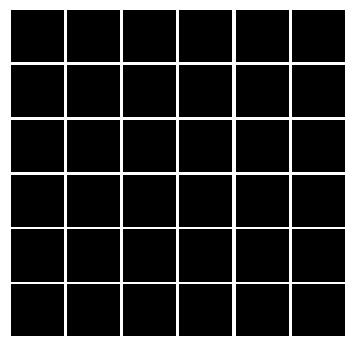


Iter:16200, D:nan, G:nan
epoch:3241---------------------------------
Iter:16205, D:nan, G:nan
epoch:3242---------------------------------
Iter:16210, D:nan, G:nan
epoch:3243---------------------------------
Iter:16215, D:nan, G:nan
epoch:3244---------------------------------
Iter:16220, D:nan, G:nan
epoch:3245---------------------------------
Iter:16225, D:nan, G:nan
epoch:3246---------------------------------
Iter:16230, D:nan, G:nan
epoch:3247---------------------------------
Iter:16235, D:nan, G:nan
epoch:3248---------------------------------
Iter:16240, D:nan, G:nan
epoch:3249---------------------------------
Iter:16245, D:nan, G:nan
epoch:3250---------------------------------
Iter:16250, D:nan, G:nan
epoch:3251---------------------------------
Iter:16255, D:nan, G:nan
epoch:3252---------------------------------
Iter:16260, D:nan, G:nan
epoch:3253---------------------------------
Iter:16265, D:nan, G:nan
epoch:3254---------------------------------
Iter:16270, D:nan, G:nan
epoch:32

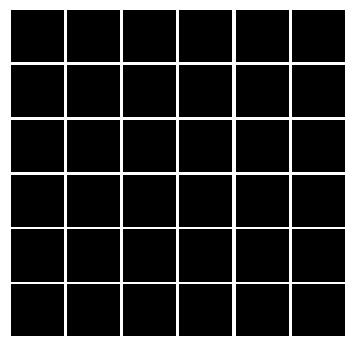


Iter:16400, D:nan, G:nan
epoch:3281---------------------------------
Iter:16405, D:nan, G:nan
epoch:3282---------------------------------
Iter:16410, D:nan, G:nan
epoch:3283---------------------------------
Iter:16415, D:nan, G:nan
epoch:3284---------------------------------
Iter:16420, D:nan, G:nan
epoch:3285---------------------------------
Iter:16425, D:nan, G:nan
epoch:3286---------------------------------
Iter:16430, D:nan, G:nan
epoch:3287---------------------------------
Iter:16435, D:nan, G:nan
epoch:3288---------------------------------
Iter:16440, D:nan, G:nan
epoch:3289---------------------------------
Iter:16445, D:nan, G:nan
epoch:3290---------------------------------
Iter:16450, D:nan, G:nan
epoch:3291---------------------------------
Iter:16455, D:nan, G:nan
epoch:3292---------------------------------
Iter:16460, D:nan, G:nan
epoch:3293---------------------------------
Iter:16465, D:nan, G:nan
epoch:3294---------------------------------
Iter:16470, D:nan, G:nan
epoch:32

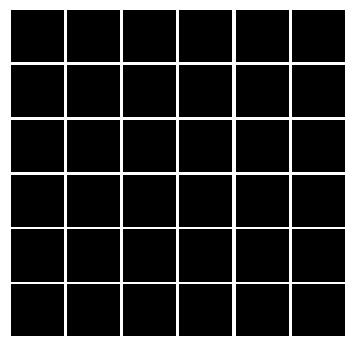


Iter:16600, D:nan, G:nan
epoch:3321---------------------------------
Iter:16605, D:nan, G:nan
epoch:3322---------------------------------
Iter:16610, D:nan, G:nan
epoch:3323---------------------------------
Iter:16615, D:nan, G:nan
epoch:3324---------------------------------
Iter:16620, D:nan, G:nan
epoch:3325---------------------------------
Iter:16625, D:nan, G:nan
epoch:3326---------------------------------
Iter:16630, D:nan, G:nan
epoch:3327---------------------------------
Iter:16635, D:nan, G:nan
epoch:3328---------------------------------
Iter:16640, D:nan, G:nan
epoch:3329---------------------------------
Iter:16645, D:nan, G:nan
epoch:3330---------------------------------
Iter:16650, D:nan, G:nan
epoch:3331---------------------------------
Iter:16655, D:nan, G:nan
epoch:3332---------------------------------
Iter:16660, D:nan, G:nan
epoch:3333---------------------------------
Iter:16665, D:nan, G:nan
epoch:3334---------------------------------
Iter:16670, D:nan, G:nan
epoch:33

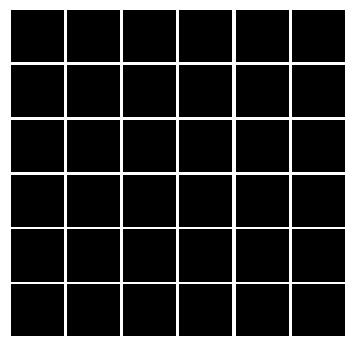


Iter:16800, D:nan, G:nan
epoch:3361---------------------------------
Iter:16805, D:nan, G:nan
epoch:3362---------------------------------
Iter:16810, D:nan, G:nan
epoch:3363---------------------------------
Iter:16815, D:nan, G:nan
epoch:3364---------------------------------
Iter:16820, D:nan, G:nan
epoch:3365---------------------------------
Iter:16825, D:nan, G:nan
epoch:3366---------------------------------
Iter:16830, D:nan, G:nan
epoch:3367---------------------------------
Iter:16835, D:nan, G:nan
epoch:3368---------------------------------
Iter:16840, D:nan, G:nan
epoch:3369---------------------------------
Iter:16845, D:nan, G:nan
epoch:3370---------------------------------
Iter:16850, D:nan, G:nan
epoch:3371---------------------------------
Iter:16855, D:nan, G:nan
epoch:3372---------------------------------
Iter:16860, D:nan, G:nan
epoch:3373---------------------------------
Iter:16865, D:nan, G:nan
epoch:3374---------------------------------
Iter:16870, D:nan, G:nan
epoch:33

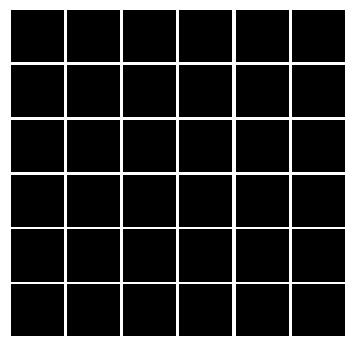


Iter:17000, D:nan, G:nan
epoch:3401---------------------------------
Iter:17005, D:nan, G:nan
epoch:3402---------------------------------
Iter:17010, D:nan, G:nan
epoch:3403---------------------------------
Iter:17015, D:nan, G:nan
epoch:3404---------------------------------
Iter:17020, D:nan, G:nan
epoch:3405---------------------------------
Iter:17025, D:nan, G:nan
epoch:3406---------------------------------
Iter:17030, D:nan, G:nan
epoch:3407---------------------------------
Iter:17035, D:nan, G:nan
epoch:3408---------------------------------
Iter:17040, D:nan, G:nan
epoch:3409---------------------------------
Iter:17045, D:nan, G:nan
epoch:3410---------------------------------
Iter:17050, D:nan, G:nan
epoch:3411---------------------------------
Iter:17055, D:nan, G:nan
epoch:3412---------------------------------
Iter:17060, D:nan, G:nan
epoch:3413---------------------------------
Iter:17065, D:nan, G:nan
epoch:3414---------------------------------
Iter:17070, D:nan, G:nan
epoch:34

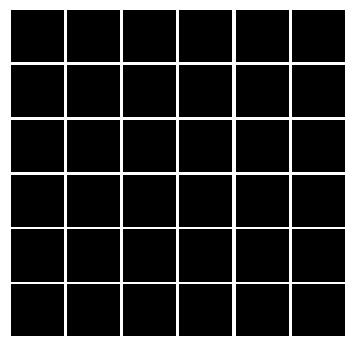


Iter:17200, D:nan, G:nan
epoch:3441---------------------------------
Iter:17205, D:nan, G:nan
epoch:3442---------------------------------
Iter:17210, D:nan, G:nan
epoch:3443---------------------------------
Iter:17215, D:nan, G:nan
epoch:3444---------------------------------
Iter:17220, D:nan, G:nan
epoch:3445---------------------------------
Iter:17225, D:nan, G:nan
epoch:3446---------------------------------
Iter:17230, D:nan, G:nan
epoch:3447---------------------------------
Iter:17235, D:nan, G:nan
epoch:3448---------------------------------
Iter:17240, D:nan, G:nan
epoch:3449---------------------------------
Iter:17245, D:nan, G:nan
epoch:3450---------------------------------
Iter:17250, D:nan, G:nan
epoch:3451---------------------------------
Iter:17255, D:nan, G:nan
epoch:3452---------------------------------
Iter:17260, D:nan, G:nan
epoch:3453---------------------------------
Iter:17265, D:nan, G:nan
epoch:3454---------------------------------
Iter:17270, D:nan, G:nan
epoch:34

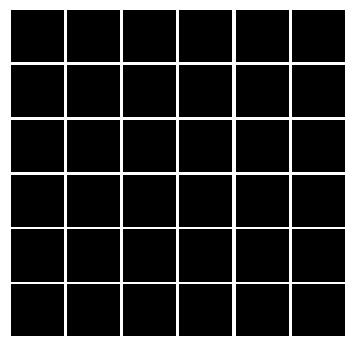


Iter:17400, D:nan, G:nan
epoch:3481---------------------------------
Iter:17405, D:nan, G:nan
epoch:3482---------------------------------
Iter:17410, D:nan, G:nan
epoch:3483---------------------------------
Iter:17415, D:nan, G:nan
epoch:3484---------------------------------
Iter:17420, D:nan, G:nan
epoch:3485---------------------------------
Iter:17425, D:nan, G:nan
epoch:3486---------------------------------
Iter:17430, D:nan, G:nan
epoch:3487---------------------------------
Iter:17435, D:nan, G:nan
epoch:3488---------------------------------
Iter:17440, D:nan, G:nan
epoch:3489---------------------------------
Iter:17445, D:nan, G:nan
epoch:3490---------------------------------
Iter:17450, D:nan, G:nan
epoch:3491---------------------------------
Iter:17455, D:nan, G:nan
epoch:3492---------------------------------
Iter:17460, D:nan, G:nan
epoch:3493---------------------------------
Iter:17465, D:nan, G:nan
epoch:3494---------------------------------
Iter:17470, D:nan, G:nan
epoch:34

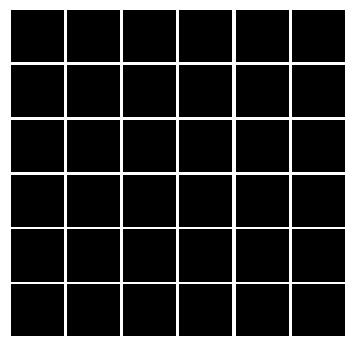


Iter:17600, D:nan, G:nan
epoch:3521---------------------------------
Iter:17605, D:nan, G:nan
epoch:3522---------------------------------
Iter:17610, D:nan, G:nan
epoch:3523---------------------------------
Iter:17615, D:nan, G:nan
epoch:3524---------------------------------
Iter:17620, D:nan, G:nan
epoch:3525---------------------------------
Iter:17625, D:nan, G:nan
epoch:3526---------------------------------
Iter:17630, D:nan, G:nan
epoch:3527---------------------------------
Iter:17635, D:nan, G:nan
epoch:3528---------------------------------
Iter:17640, D:nan, G:nan
epoch:3529---------------------------------
Iter:17645, D:nan, G:nan
epoch:3530---------------------------------
Iter:17650, D:nan, G:nan
epoch:3531---------------------------------
Iter:17655, D:nan, G:nan
epoch:3532---------------------------------
Iter:17660, D:nan, G:nan
epoch:3533---------------------------------
Iter:17665, D:nan, G:nan
epoch:3534---------------------------------
Iter:17670, D:nan, G:nan
epoch:35

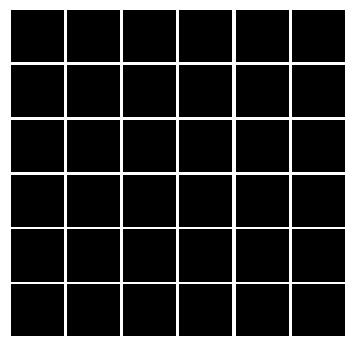


Iter:17800, D:nan, G:nan
epoch:3561---------------------------------
Iter:17805, D:nan, G:nan
epoch:3562---------------------------------
Iter:17810, D:nan, G:nan
epoch:3563---------------------------------
Iter:17815, D:nan, G:nan
epoch:3564---------------------------------
Iter:17820, D:nan, G:nan
epoch:3565---------------------------------
Iter:17825, D:nan, G:nan
epoch:3566---------------------------------
Iter:17830, D:nan, G:nan
epoch:3567---------------------------------
Iter:17835, D:nan, G:nan
epoch:3568---------------------------------
Iter:17840, D:nan, G:nan
epoch:3569---------------------------------
Iter:17845, D:nan, G:nan
epoch:3570---------------------------------
Iter:17850, D:nan, G:nan
epoch:3571---------------------------------
Iter:17855, D:nan, G:nan
epoch:3572---------------------------------
Iter:17860, D:nan, G:nan
epoch:3573---------------------------------
Iter:17865, D:nan, G:nan
epoch:3574---------------------------------
Iter:17870, D:nan, G:nan
epoch:35

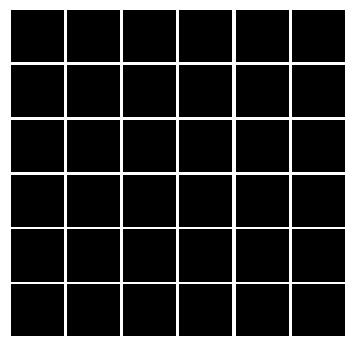


Iter:18000, D:nan, G:nan
epoch:3601---------------------------------
Iter:18005, D:nan, G:nan
epoch:3602---------------------------------
Iter:18010, D:nan, G:nan
epoch:3603---------------------------------
Iter:18015, D:nan, G:nan
epoch:3604---------------------------------
Iter:18020, D:nan, G:nan
epoch:3605---------------------------------
Iter:18025, D:nan, G:nan
epoch:3606---------------------------------
Iter:18030, D:nan, G:nan
epoch:3607---------------------------------
Iter:18035, D:nan, G:nan
epoch:3608---------------------------------
Iter:18040, D:nan, G:nan
epoch:3609---------------------------------
Iter:18045, D:nan, G:nan
epoch:3610---------------------------------
Iter:18050, D:nan, G:nan
epoch:3611---------------------------------
Iter:18055, D:nan, G:nan
epoch:3612---------------------------------
Iter:18060, D:nan, G:nan
epoch:3613---------------------------------
Iter:18065, D:nan, G:nan
epoch:3614---------------------------------
Iter:18070, D:nan, G:nan
epoch:36

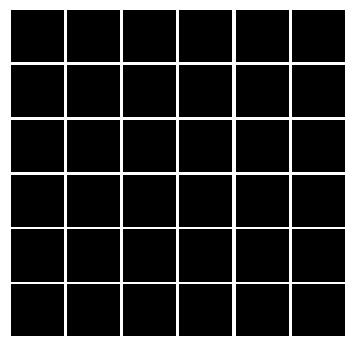


Iter:18200, D:nan, G:nan
epoch:3641---------------------------------
Iter:18205, D:nan, G:nan
epoch:3642---------------------------------
Iter:18210, D:nan, G:nan
epoch:3643---------------------------------
Iter:18215, D:nan, G:nan
epoch:3644---------------------------------
Iter:18220, D:nan, G:nan
epoch:3645---------------------------------
Iter:18225, D:nan, G:nan
epoch:3646---------------------------------
Iter:18230, D:nan, G:nan
epoch:3647---------------------------------
Iter:18235, D:nan, G:nan
epoch:3648---------------------------------
Iter:18240, D:nan, G:nan
epoch:3649---------------------------------
Iter:18245, D:nan, G:nan
epoch:3650---------------------------------
Iter:18250, D:nan, G:nan
epoch:3651---------------------------------
Iter:18255, D:nan, G:nan
epoch:3652---------------------------------
Iter:18260, D:nan, G:nan
epoch:3653---------------------------------
Iter:18265, D:nan, G:nan
epoch:3654---------------------------------
Iter:18270, D:nan, G:nan
epoch:36

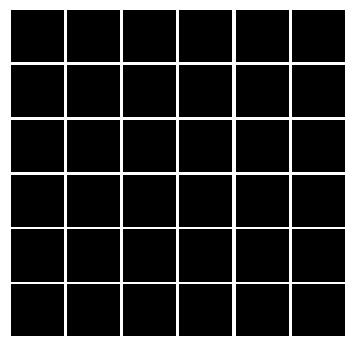


Iter:18400, D:nan, G:nan
epoch:3681---------------------------------
Iter:18405, D:nan, G:nan
epoch:3682---------------------------------
Iter:18410, D:nan, G:nan
epoch:3683---------------------------------
Iter:18415, D:nan, G:nan
epoch:3684---------------------------------
Iter:18420, D:nan, G:nan
epoch:3685---------------------------------
Iter:18425, D:nan, G:nan
epoch:3686---------------------------------
Iter:18430, D:nan, G:nan
epoch:3687---------------------------------
Iter:18435, D:nan, G:nan
epoch:3688---------------------------------
Iter:18440, D:nan, G:nan
epoch:3689---------------------------------
Iter:18445, D:nan, G:nan
epoch:3690---------------------------------
Iter:18450, D:nan, G:nan
epoch:3691---------------------------------
Iter:18455, D:nan, G:nan
epoch:3692---------------------------------
Iter:18460, D:nan, G:nan
epoch:3693---------------------------------
Iter:18465, D:nan, G:nan
epoch:3694---------------------------------
Iter:18470, D:nan, G:nan
epoch:36

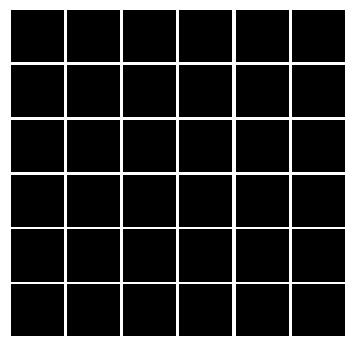


Iter:18600, D:nan, G:nan
epoch:3721---------------------------------
Iter:18605, D:nan, G:nan
epoch:3722---------------------------------
Iter:18610, D:nan, G:nan
epoch:3723---------------------------------
Iter:18615, D:nan, G:nan
epoch:3724---------------------------------
Iter:18620, D:nan, G:nan
epoch:3725---------------------------------
Iter:18625, D:nan, G:nan
epoch:3726---------------------------------
Iter:18630, D:nan, G:nan
epoch:3727---------------------------------
Iter:18635, D:nan, G:nan
epoch:3728---------------------------------
Iter:18640, D:nan, G:nan
epoch:3729---------------------------------
Iter:18645, D:nan, G:nan
epoch:3730---------------------------------
Iter:18650, D:nan, G:nan
epoch:3731---------------------------------
Iter:18655, D:nan, G:nan
epoch:3732---------------------------------
Iter:18660, D:nan, G:nan
epoch:3733---------------------------------
Iter:18665, D:nan, G:nan
epoch:3734---------------------------------
Iter:18670, D:nan, G:nan
epoch:37

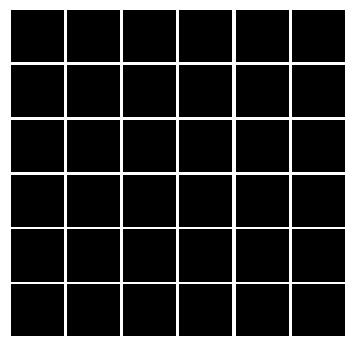


Iter:18800, D:nan, G:nan
epoch:3761---------------------------------
Iter:18805, D:nan, G:nan
epoch:3762---------------------------------
Iter:18810, D:nan, G:nan
epoch:3763---------------------------------
Iter:18815, D:nan, G:nan
epoch:3764---------------------------------
Iter:18820, D:nan, G:nan
epoch:3765---------------------------------
Iter:18825, D:nan, G:nan
epoch:3766---------------------------------
Iter:18830, D:nan, G:nan
epoch:3767---------------------------------
Iter:18835, D:nan, G:nan
epoch:3768---------------------------------
Iter:18840, D:nan, G:nan
epoch:3769---------------------------------
Iter:18845, D:nan, G:nan
epoch:3770---------------------------------
Iter:18850, D:nan, G:nan
epoch:3771---------------------------------
Iter:18855, D:nan, G:nan
epoch:3772---------------------------------
Iter:18860, D:nan, G:nan
epoch:3773---------------------------------
Iter:18865, D:nan, G:nan
epoch:3774---------------------------------
Iter:18870, D:nan, G:nan
epoch:37

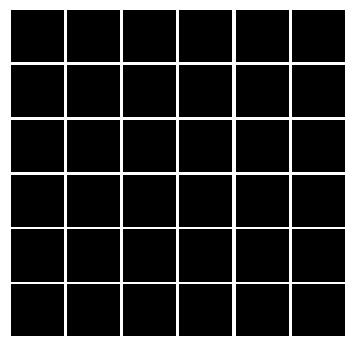


Iter:19000, D:nan, G:nan
epoch:3801---------------------------------
Iter:19005, D:nan, G:nan
epoch:3802---------------------------------
Iter:19010, D:nan, G:nan
epoch:3803---------------------------------
Iter:19015, D:nan, G:nan
epoch:3804---------------------------------
Iter:19020, D:nan, G:nan
epoch:3805---------------------------------
Iter:19025, D:nan, G:nan
epoch:3806---------------------------------
Iter:19030, D:nan, G:nan
epoch:3807---------------------------------
Iter:19035, D:nan, G:nan
epoch:3808---------------------------------
Iter:19040, D:nan, G:nan
epoch:3809---------------------------------
Iter:19045, D:nan, G:nan
epoch:3810---------------------------------
Iter:19050, D:nan, G:nan
epoch:3811---------------------------------
Iter:19055, D:nan, G:nan
epoch:3812---------------------------------
Iter:19060, D:nan, G:nan
epoch:3813---------------------------------
Iter:19065, D:nan, G:nan
epoch:3814---------------------------------
Iter:19070, D:nan, G:nan
epoch:38

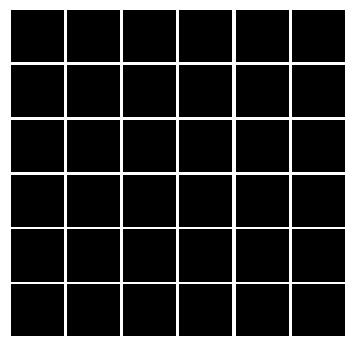


Iter:19200, D:nan, G:nan
epoch:3841---------------------------------
Iter:19205, D:nan, G:nan
epoch:3842---------------------------------
Iter:19210, D:nan, G:nan
epoch:3843---------------------------------
Iter:19215, D:nan, G:nan
epoch:3844---------------------------------
Iter:19220, D:nan, G:nan
epoch:3845---------------------------------
Iter:19225, D:nan, G:nan
epoch:3846---------------------------------
Iter:19230, D:nan, G:nan
epoch:3847---------------------------------
Iter:19235, D:nan, G:nan
epoch:3848---------------------------------
Iter:19240, D:nan, G:nan
epoch:3849---------------------------------
Iter:19245, D:nan, G:nan
epoch:3850---------------------------------
Iter:19250, D:nan, G:nan
epoch:3851---------------------------------
Iter:19255, D:nan, G:nan
epoch:3852---------------------------------
Iter:19260, D:nan, G:nan
epoch:3853---------------------------------
Iter:19265, D:nan, G:nan
epoch:3854---------------------------------
Iter:19270, D:nan, G:nan
epoch:38

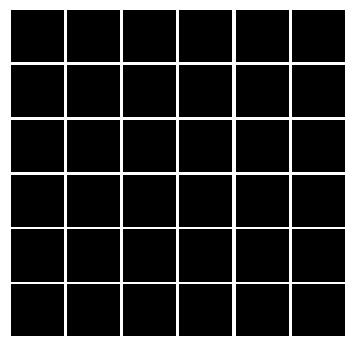


Iter:19400, D:nan, G:nan
epoch:3881---------------------------------
Iter:19405, D:nan, G:nan
epoch:3882---------------------------------
Iter:19410, D:nan, G:nan
epoch:3883---------------------------------
Iter:19415, D:nan, G:nan
epoch:3884---------------------------------
Iter:19420, D:nan, G:nan
epoch:3885---------------------------------
Iter:19425, D:nan, G:nan
epoch:3886---------------------------------
Iter:19430, D:nan, G:nan
epoch:3887---------------------------------
Iter:19435, D:nan, G:nan
epoch:3888---------------------------------
Iter:19440, D:nan, G:nan
epoch:3889---------------------------------
Iter:19445, D:nan, G:nan
epoch:3890---------------------------------
Iter:19450, D:nan, G:nan
epoch:3891---------------------------------
Iter:19455, D:nan, G:nan
epoch:3892---------------------------------
Iter:19460, D:nan, G:nan
epoch:3893---------------------------------
Iter:19465, D:nan, G:nan
epoch:3894---------------------------------
Iter:19470, D:nan, G:nan
epoch:38

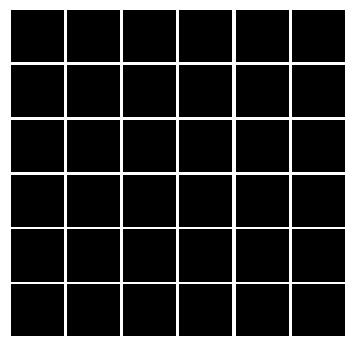


Iter:19600, D:nan, G:nan
epoch:3921---------------------------------
Iter:19605, D:nan, G:nan
epoch:3922---------------------------------
Iter:19610, D:nan, G:nan
epoch:3923---------------------------------
Iter:19615, D:nan, G:nan
epoch:3924---------------------------------
Iter:19620, D:nan, G:nan
epoch:3925---------------------------------
Iter:19625, D:nan, G:nan
epoch:3926---------------------------------
Iter:19630, D:nan, G:nan
epoch:3927---------------------------------
Iter:19635, D:nan, G:nan
epoch:3928---------------------------------
Iter:19640, D:nan, G:nan
epoch:3929---------------------------------
Iter:19645, D:nan, G:nan
epoch:3930---------------------------------
Iter:19650, D:nan, G:nan
epoch:3931---------------------------------
Iter:19655, D:nan, G:nan
epoch:3932---------------------------------
Iter:19660, D:nan, G:nan
epoch:3933---------------------------------
Iter:19665, D:nan, G:nan
epoch:3934---------------------------------
Iter:19670, D:nan, G:nan
epoch:39

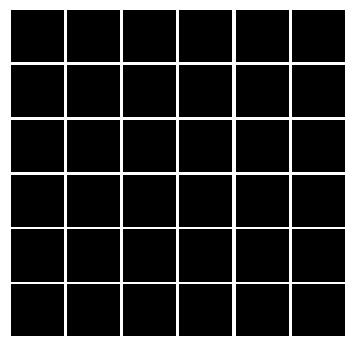


Iter:19800, D:nan, G:nan
epoch:3961---------------------------------
Iter:19805, D:nan, G:nan
epoch:3962---------------------------------
Iter:19810, D:nan, G:nan
epoch:3963---------------------------------
Iter:19815, D:nan, G:nan
epoch:3964---------------------------------
Iter:19820, D:nan, G:nan
epoch:3965---------------------------------
Iter:19825, D:nan, G:nan
epoch:3966---------------------------------
Iter:19830, D:nan, G:nan
epoch:3967---------------------------------
Iter:19835, D:nan, G:nan
epoch:3968---------------------------------
Iter:19840, D:nan, G:nan
epoch:3969---------------------------------
Iter:19845, D:nan, G:nan
epoch:3970---------------------------------
Iter:19850, D:nan, G:nan
epoch:3971---------------------------------
Iter:19855, D:nan, G:nan
epoch:3972---------------------------------
Iter:19860, D:nan, G:nan
epoch:3973---------------------------------
Iter:19865, D:nan, G:nan
epoch:3974---------------------------------
Iter:19870, D:nan, G:nan
epoch:39

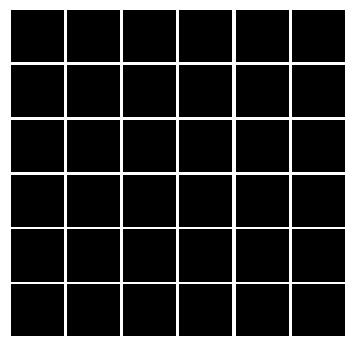


Iter:20000, D:nan, G:nan
epoch:4001---------------------------------
Iter:20005, D:nan, G:nan
epoch:4002---------------------------------
Iter:20010, D:nan, G:nan
epoch:4003---------------------------------
Iter:20015, D:nan, G:nan
epoch:4004---------------------------------
Iter:20020, D:nan, G:nan
epoch:4005---------------------------------
Iter:20025, D:nan, G:nan
epoch:4006---------------------------------
Iter:20030, D:nan, G:nan
epoch:4007---------------------------------
Iter:20035, D:nan, G:nan
epoch:4008---------------------------------
Iter:20040, D:nan, G:nan
epoch:4009---------------------------------
Iter:20045, D:nan, G:nan
epoch:4010---------------------------------
Iter:20050, D:nan, G:nan
epoch:4011---------------------------------
Iter:20055, D:nan, G:nan
epoch:4012---------------------------------
Iter:20060, D:nan, G:nan
epoch:4013---------------------------------
Iter:20065, D:nan, G:nan
epoch:4014---------------------------------
Iter:20070, D:nan, G:nan
epoch:40

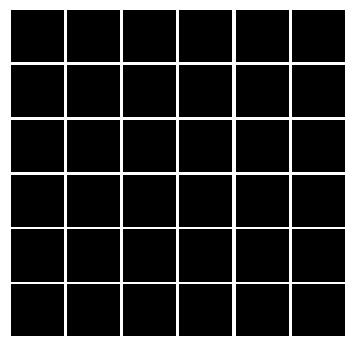


Iter:20200, D:nan, G:nan
epoch:4041---------------------------------
Iter:20205, D:nan, G:nan
epoch:4042---------------------------------
Iter:20210, D:nan, G:nan
epoch:4043---------------------------------
Iter:20215, D:nan, G:nan
epoch:4044---------------------------------
Iter:20220, D:nan, G:nan
epoch:4045---------------------------------
Iter:20225, D:nan, G:nan
epoch:4046---------------------------------
Iter:20230, D:nan, G:nan
epoch:4047---------------------------------
Iter:20235, D:nan, G:nan
epoch:4048---------------------------------
Iter:20240, D:nan, G:nan
epoch:4049---------------------------------
Iter:20245, D:nan, G:nan
epoch:4050---------------------------------
Iter:20250, D:nan, G:nan
epoch:4051---------------------------------
Iter:20255, D:nan, G:nan
epoch:4052---------------------------------
Iter:20260, D:nan, G:nan
epoch:4053---------------------------------
Iter:20265, D:nan, G:nan
epoch:4054---------------------------------
Iter:20270, D:nan, G:nan
epoch:40

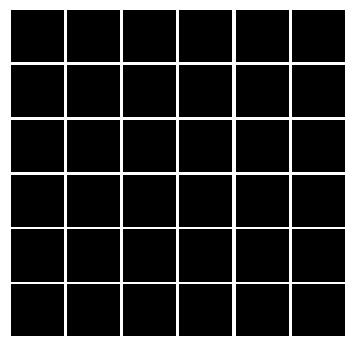


Iter:20400, D:nan, G:nan
epoch:4081---------------------------------
Iter:20405, D:nan, G:nan
epoch:4082---------------------------------
Iter:20410, D:nan, G:nan
epoch:4083---------------------------------
Iter:20415, D:nan, G:nan
epoch:4084---------------------------------
Iter:20420, D:nan, G:nan
epoch:4085---------------------------------
Iter:20425, D:nan, G:nan
epoch:4086---------------------------------
Iter:20430, D:nan, G:nan
epoch:4087---------------------------------
Iter:20435, D:nan, G:nan
epoch:4088---------------------------------
Iter:20440, D:nan, G:nan
epoch:4089---------------------------------
Iter:20445, D:nan, G:nan
epoch:4090---------------------------------
Iter:20450, D:nan, G:nan
epoch:4091---------------------------------
Iter:20455, D:nan, G:nan
epoch:4092---------------------------------
Iter:20460, D:nan, G:nan
epoch:4093---------------------------------
Iter:20465, D:nan, G:nan
epoch:4094---------------------------------
Iter:20470, D:nan, G:nan
epoch:40

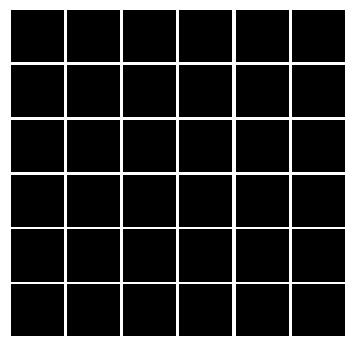


Iter:20600, D:nan, G:nan
epoch:4121---------------------------------
Iter:20605, D:nan, G:nan
epoch:4122---------------------------------
Iter:20610, D:nan, G:nan
epoch:4123---------------------------------
Iter:20615, D:nan, G:nan
epoch:4124---------------------------------
Iter:20620, D:nan, G:nan
epoch:4125---------------------------------
Iter:20625, D:nan, G:nan
epoch:4126---------------------------------
Iter:20630, D:nan, G:nan
epoch:4127---------------------------------
Iter:20635, D:nan, G:nan
epoch:4128---------------------------------
Iter:20640, D:nan, G:nan
epoch:4129---------------------------------
Iter:20645, D:nan, G:nan
epoch:4130---------------------------------
Iter:20650, D:nan, G:nan
epoch:4131---------------------------------
Iter:20655, D:nan, G:nan
epoch:4132---------------------------------
Iter:20660, D:nan, G:nan
epoch:4133---------------------------------
Iter:20665, D:nan, G:nan
epoch:4134---------------------------------
Iter:20670, D:nan, G:nan
epoch:41

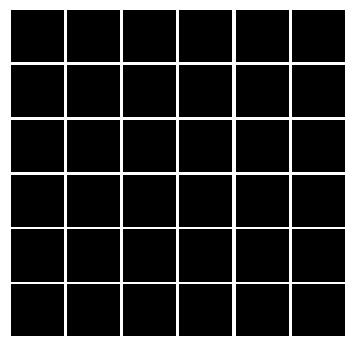


Iter:20800, D:nan, G:nan
epoch:4161---------------------------------
Iter:20805, D:nan, G:nan
epoch:4162---------------------------------
Iter:20810, D:nan, G:nan
epoch:4163---------------------------------
Iter:20815, D:nan, G:nan
epoch:4164---------------------------------
Iter:20820, D:nan, G:nan
epoch:4165---------------------------------
Iter:20825, D:nan, G:nan
epoch:4166---------------------------------
Iter:20830, D:nan, G:nan
epoch:4167---------------------------------
Iter:20835, D:nan, G:nan
epoch:4168---------------------------------
Iter:20840, D:nan, G:nan
epoch:4169---------------------------------
Iter:20845, D:nan, G:nan
epoch:4170---------------------------------
Iter:20850, D:nan, G:nan
epoch:4171---------------------------------
Iter:20855, D:nan, G:nan
epoch:4172---------------------------------
Iter:20860, D:nan, G:nan
epoch:4173---------------------------------
Iter:20865, D:nan, G:nan
epoch:4174---------------------------------
Iter:20870, D:nan, G:nan
epoch:41

In [ ]:
tf.reset_default_graph()
img_size = cifar_10.shape[1]
x = tf.placeholder(tf.float32,[batch_size,img_size*img_size*3])#----------------------------------------change para
img_real = x
z = sample_noise(batch_size,noise_dim) 
G_sample = generator(z)#output [batch,96*96*3]
out_img = tf.reshape(deprocess(G_sample[:save_size]),[-1,img_size,img_size,3])#------------------------change para  #resize shape. 9696

                                                        #output = [batch,96,96,3] 

with tf.variable_scope("") as scope:
    logits_real = discriminator(preprocess(x))
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)
    
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator')
d_solver,g_solver = get_solvers()

d_loss,g_loss = wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample) #change loss oneonoeneone ----------------
d_train_step = d_solver.minimize(d_loss,var_list=D_vars)
g_train_step = g_solver.minimize(g_loss,var_list=G_vars)
d_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
g_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')
tf.summary.image("image",out_img,max_outputs=save_size)
merged = tf.summary.merge_all()

with session() as sess:
    try:
        with tf.device("/gpu:0") as dev:
            #merged
            
            ##initialize
            sess.run(tf.global_variables_initializer())
            
            
            train_writer = tf.summary.FileWriter(log_dir,sess.graph)
            
            train(sess,g_train_step,g_loss,d_train_step,d_loss,g_extra_step,d_extra_step,
                  show_every=200,print_every=5,batch_size=batch_size,num_epoch=5000)    
    except tf.errors.InvalidArgumentError:
        print("no gpu found, please use Google Cloud if you want GPU acceleration") 
